In [2]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import re

In [3]:
numeric_pattern = r"\(\s*\d+\s*/\s*\d+\s*\)"

In [4]:
def process_data(text):
    matches = re.findall(pattern=numeric_pattern, string=text)
    if len(matches):
        text = re.sub(pattern=numeric_pattern, repl='', string=text)
    return text

In [5]:
with open('../data/train.txt', 'r') as file:
    lines = file.readlines()
    lines = lines[:10000]

In [6]:
for line in lines:
    print(line)

وَلَوْ جَمَعَ ثُمَّ عَلِمَ تَرْكَ رُكْنٍ مِنْ الْأُولَى بَطَلَتَا وَيُعِيدُهُمَا جَامِعًا ، أَوْ مِنْ الثَّانِيَةِ ، فَإِنْ لَمْ يَطُلْ تَدَارَكَ ، وَإِلَّا فَبَاطِلَةٌ وَلَا جَمَعَ ، وَلَوْ جَهِلَ أَعَادَهُمَا لِوَقْتَيْهِمَا

قَالَ أَبُو زَيْدٍ أَهْلُ تِهَامَةَ يُؤَنِّثُونَ الْعَضُدَ وَبَنُو تَمِيمٍ يُذَكِّرُونَ ، وَالْجَمْعُ أَعْضُدٌ وَأَعْضَادٌ مِثْلُ أَفْلُسٍ وَأَقْفَالٍ( 24 / 355 )

بِمَنْزِلَةِ أَهْلِ الذِّمَّةِ إذَا دَخَلُوا قَرْيَةً مِنْ قُرَى أَهْلِ الْحَرْبِ ثُمَّ ظَفِرَ الْمُسْلِمُونَ بِهَا فَهُمْ فَيْءٌ أَجْمَعُونَ إلَّا مِنْ عُرِفَ أَنَّهُ ذِمِّيٌّ .

الْمَسْأَلَةُ الْخَامِسَةُ قَوْله تَعَالَى : { الَّذِينَ يُظَاهِرُونَ } حَقِيقَتُهُ تَشْبِيهُ ظَهْرٍ [ بِظَهْرٍ ، وَالْمُوجِبُ لِلْحُكْمِ مِنْهُ تَشْبِيهُ ظَهْرِ ] مُحَلَّلٍ بِظَهْرِ مُحَرَّمٍ ، وَيَتَفَرَّعُ عَلَيْهِ فُرُوعٌ كَثِيرَةٌ ، أُصُولُهَا سَبْعَةٌ : الْفَرْعُ الْأَوَّلُ : إذَا شَبَّهَ جُمْلَةَ أَهْلِهِ بِظَهْرِ أُمِّهِ ، كَمَا جَاءَ فِي الْحَدِيثِ أَنَّهُ قَالَ : أَنْتِ عَلَيَّ كَظَهْرِ أُمِّي .

قَوْلُهُ ( وَاَلَّ

In [7]:
new_lines = []
new_val_lines = []
for line in lines:
    merged = process_data(line)
    new_lines.append(merged)

In [8]:
english = r"[a-zA-Z]"

for new_line in new_lines:
    matches = re.findall(english, new_line)
    if len(matches):
        print(matches)

In [9]:
numbers = r"\s*\d+\s*"
numering_items = r"\s*\d+\s*[-]\s*"
empty_brackets = r'\(\s*\)|\[\s*\]|\{\s*\}|<<\s*>>|"\s*"|\'\s*\''

In [10]:
def remove_numbers(lines):
    new_lines = []
    for line in lines:
        res = re.sub(numering_items, '', line)
        res = re.sub(numbers, '', res)
        res = re.sub(empty_brackets, '', res)
        res = re.sub(r'\*', '', res)
        res = re.sub(',', '،', res)
        res = re.sub(';', '؛', res)
        res = re.sub(r'–', '-', res)
        new_lines.append(res)
    return new_lines

In [11]:
new_lines = remove_numbers(new_lines)

In [12]:
new_lines

['وَلَوْ جَمَعَ ثُمَّ عَلِمَ تَرْكَ رُكْنٍ مِنْ الْأُولَى بَطَلَتَا وَيُعِيدُهُمَا جَامِعًا ، أَوْ مِنْ الثَّانِيَةِ ، فَإِنْ لَمْ يَطُلْ تَدَارَكَ ، وَإِلَّا فَبَاطِلَةٌ وَلَا جَمَعَ ، وَلَوْ جَهِلَ أَعَادَهُمَا لِوَقْتَيْهِمَا\n',
 'قَالَ أَبُو زَيْدٍ أَهْلُ تِهَامَةَ يُؤَنِّثُونَ الْعَضُدَ وَبَنُو تَمِيمٍ يُذَكِّرُونَ ، وَالْجَمْعُ أَعْضُدٌ وَأَعْضَادٌ مِثْلُ أَفْلُسٍ وَأَقْفَالٍ\n',
 'بِمَنْزِلَةِ أَهْلِ الذِّمَّةِ إذَا دَخَلُوا قَرْيَةً مِنْ قُرَى أَهْلِ الْحَرْبِ ثُمَّ ظَفِرَ الْمُسْلِمُونَ بِهَا فَهُمْ فَيْءٌ أَجْمَعُونَ إلَّا مِنْ عُرِفَ أَنَّهُ ذِمِّيٌّ .\n',
 'الْمَسْأَلَةُ الْخَامِسَةُ قَوْله تَعَالَى : { الَّذِينَ يُظَاهِرُونَ } حَقِيقَتُهُ تَشْبِيهُ ظَهْرٍ [ بِظَهْرٍ ، وَالْمُوجِبُ لِلْحُكْمِ مِنْهُ تَشْبِيهُ ظَهْرِ ] مُحَلَّلٍ بِظَهْرِ مُحَرَّمٍ ، وَيَتَفَرَّعُ عَلَيْهِ فُرُوعٌ كَثِيرَةٌ ، أُصُولُهَا سَبْعَةٌ : الْفَرْعُ الْأَوَّلُ : إذَا شَبَّهَ جُمْلَةَ أَهْلِهِ بِظَهْرِ أُمِّهِ ، كَمَا جَاءَ فِي الْحَدِيثِ أَنَّهُ قَالَ : أَنْتِ عَلَيَّ كَظَهْرِ أُمِّي .\n',
 'قَوْلُهُ

In [13]:
import string

def contains_special_chars_punctuation(text):
    special_chars = set(string.punctuation)
    special_chars.add('،') 
    special_chars.add('؛') 
    special_chars.add('؟')

    return [char for char in text if char in special_chars ]

In [14]:
my_punc_set = {}
for new_line in new_lines:
    specials = contains_special_chars_punctuation(new_line)
    for special in specials:
        my_punc_set[special] = my_punc_set.get(special, 0) + 1


In [15]:
my_punc_set

{'،': 14819,
 '.': 8071,
 ':': 8275,
 '{': 676,
 '}': 685,
 '[': 351,
 ']': 351,
 '(': 10636,
 ')': 10711,
 '؛': 2492,
 '؟': 427,
 '/': 32,
 '-': 435,
 '!': 3,
 "'": 1,
 '"': 4,
 '`': 1,
 '~': 1}

In [16]:
def get_between(starting_symbol, ending_symbol, text):
    target_start = re.escape(starting_symbol)
    target_end = re.escape(ending_symbol)

    pattern = rf"{target_start}(.*?){target_end}"

    matches = re.findall(pattern, text, flags=re.DOTALL)
    return matches or None


In [17]:
import re

def get_context(to_search, text, c=10):
    target = re.escape(to_search) 
    
    word = r"\S+"
    
    pattern = (
        rf"(?:{word}\s+){{0,{c}}}"  # Match 0 to c words BEFORE
        rf"{target}"                # The target (e.g., -)
        rf"(?:\s+{word}){{0,{c}}}"  # Match 0 to c words AFTER
    )
    
    matches = re.findall(pattern, text)
    
    return matches or None

In [18]:
for i, new_line in enumerate(new_lines):    
    matches = get_context('/', new_line)
    if matches:
        print(new_line)

/اُنْظُرْ آخِرَ مَسْأَلَةٍ مِنْ تَرْجَمَةِ الْمَفْقُودِ مِنْ ابْنِ يُونُسَ /( كَالْمُنْتَجِعِ لِبَلَدِ الطَّاعُونِ أَوْ فِي زَمَنِهِ ) اللَّخْمِيِّ : مَنْ فُقِدَ بِبَلَدِهِ زَمَنَ الطَّاعُونِ أَوْ بِبَلَدٍ تَوَجَّهَ إلَيْهِ زَمَنَهُ حُكْمُهُ حُكْمُ الْمَوْتِ لِقَوْلِ مَالِكٍ فِي نَاسٍ أَصَابَهُمْ بِطَرِيقِ حَجِّهِمْ سُعَالٌ يَمُوتُ الرَّجُلُ فِي سَفَرِهِ وَلَمْ يَأْتِ لَهُمْ خَبَرُ مَوْتٍ وَلَا حَيَاةٍ تَتَزَوَّجُ نِسَاؤُهُمْ وَيُقْسَمُ مَالُهُمْ .

( وَلَا يُصَلَّى عَلَى قَبْرٍ إلَّا أَنْ يُدْفَنَ بِغَيْرِهَا ) الرِّسَالَةُ : وَمَنْ دُفِنَ وَلَمْ يُصَلَّ عَلَيْهِ وُورِيَ فَإِنَّهُ يُصَلَّى عَلَى قَبْرِهِ اُنْظُرْ قَبْلَ هَذَا عِنْدَ قَوْلِهِ : فَإِنْ دُفِنَ فَعَلَى الْقَبْرِ ( وَلَا غَائِبٍ ) اُنْظُرْ عِنْدَ قَوْلِهِ : وَلَا دُونَ الْجُلِّ ( وَلَا تُكَرَّرُ ) /قَدْ تَقَدَّمَ /.

/وَانْظُرْ زَرْعَ أَحَدِ الشَّرِيكَيْنِ وَبِنَاءَهُ فِي أَرْضٍ بَيْنَهُمَا بِغَيْرِ إذْنِ شَرِيكِهِ فِي كَوْنِهِ كَغَاصِبٍ يَقْلَعُ زَرْعَهُ وَبِنَاءَهُ أَمْ لَا لِشُبْهَةِ الشَّرِكَةِ .

ابْنُ مُحْرِزٍ : إنْ 

In [19]:
for new_line in new_lines:    
    matches = get_context(';', new_line)
    if matches:
        print(matches)

In [20]:
for new_line in new_lines:
    matches = get_context('-', new_line)
    if matches:
        print(matches)

['- وَذُكِرَ عَنْ أَبِي بَرْزَةَ الْأَسْلَمِيِّ أَنَّهُ صَلَّى رَكْعَتَيْنِ وَهُوَ آخِذٌ']
['وَفِي نَوَادِرِ بِشْرٍ عَنْ أَبِي يُوسُفَ - رَحِمَهُ اللَّهُ تَعَالَى - فِي رَجُلٍ أَوْصَى لِأُمَّهَاتِ أَوْلَادِهِ وَلَهُ أُمَّهَاتُ أَوْلَادٍ عَتَقْنَ فِي']
['مُوسَى بْنُ أَنَسٍ، عَنْ أَبِيهِ: -']
['وَعَنْ عَفَّانَ، عَنْ حَمَّادٍ، عَنْ حُمَيْدٍ، وَثَابِتٍ، كِلاهُمَا عَنْ أَنَسٍ: -']
['عَلَى صَاحِبِهِ بِرُبْعِ مَا فِي يَدِهِ عِنْدَ أَبِي حَنِيفَةَ وَمُحَمَّدٍ - رَحِمَهُمَا اللَّهُ تَعَالَى - وَلَا يُخَيَّرُ بِخِلَافِ مَا قَبْلَ الْبَيْعِ']
['وَقَوْلُهُ صَلَّى اللَّهُ عَلَيْهِ وَسَلَّم إنَّمَا هِيَ أَوْسَاخُ النَّاسِ يُرِيدُ - وَاَللَّهُ أَعْلَمُ - أَنَّهَا تُطَهِّرُ أَمْوَالَهُمْ وَتُكَفِّرُ ذُنُوبَهُمْ وَإِنَّمَا يَسُوغُ']
['وَلَا يُعْتَبَرُ نَقْلُهُ بَعْدَ ذَلِكَ ، ( بِشَرْطِ - حُضُورِ مُسْتَحِقِّهِ ) لِمَكِيلٍ وَنَحْوِهِ ، لِمَا تَقَدَّمَ مِنْ قَوْلِهِ']
[') تَكُنْ الْمُتَوَفَّى عَنْهَا حَامِلًا ( فَكَالْمُطَلَّقَةِ ) أَيْ فَعِدَّتُهَا - كَعِدَّةِ الْمُطَلَّقَةِ - ثَلَاثَةُ قُرُوءٍ إنْ كَان

In [21]:
for new_line in new_lines:
    matches = get_between('-', '-', new_line)
    if matches:
        print(matches)

[' رَحِمَهُ اللَّهُ تَعَالَى ']
[' رَحِمَهُمَا اللَّهُ تَعَالَى ']
[' وَاَللَّهُ أَعْلَمُ ']
[' كَعِدَّةِ الْمُطَلَّقَةِ ']
[' أَيْ : الْمُلْتَقِطَانِ ']
[' بِأَنْ كَانَتْ الْأُجْرَةُ تَخْتَلِفُ لِاخْتِلَافِ الْأَرْضِ بِالْقُوَّةِ وَالضَّعْفِ فِي الْمُسْتَقْبَلِ ، وَلَمْ يُوجَدْ مَنْ يَعْرِفُ التَّعْدِيلَ ']
[' قَالَ ابْنُ هِشَامٍ : وَيُقَالُ ابْنُ حُصَيْنٍ ']
['صلى الله عليه وسلم']
[' وَهُوَ طَلَّقْتُك ']
[' بِالْجَرِّ ']
['حَدَّثَنَا مُحَمَّدُ بْنُ عُبَيْدٍ حَدَّثَنَا شُرَحْبِيلُ بْنُ مُدْرِكٍ الْجُعْفِيُّ عَنْ عَبْدِ اللَّهِ بْنِ نُجَيٍّ الْحَضْرَمِيِّ عَنْ أَبِيهِ قَالَ قَالَ لِي عَلِيٌّ رَضِيَ اللَّهُ عَنْهُ كَانَتْ لِي مِنْ رَسُولِ اللَّهِ صَلَّى اللَّهُ عَلَيْهِ وَسَلَّمَ مَنْزِلَةٌ لَمْ تَكُنْ لِأَحَدٍ مِنْ الْخَلَائِقِ إِنِّي كُنْتُ آتِيهِ كُلَّ سَحَرٍ فَأُسَلِّمُ عَلَيْهِ حَتَّى يَتَنَحْنَحَ وَإِنِّي جِئْتُ ذَاتَ لَيْلَةٍ فَسَلَّمْتُ عَلَيْهِ فَقُلْتُ السَّلَامُ عَلَيْكَ يَا نَبِيَّ اللَّهِ فَقَالَ عَلَى رِسْلِكَ يَا أَبَا حَسَنٍ حَتَّى أَخْرُجَ إِلَيْكَ فَلَمَّا خَرَجَ إِلَي

In [22]:
for new_line in new_lines:
    matches = get_between('(', ')', new_line)
    if matches:
        print(matches)

[' وَاَلَّذِي لَا يَتَغَابَنُ النَّاسُ فِي مِثْلِهِ مَا لَا يَدْخُلُ تَحْتَ تَقْوِيمِ الْمُقَوِّمِينَ ']
[' سُئِلَ ']
[' وَ ', ' مَوْطُوءَةٌ بِشُبْهَةٍ ', ' أَوْ نِكَاحٍ فَاسِدٍ ']
[' قَوْلُهُ وَمِنْ صُوَرِ ذَلِكَ إلَخْ ']
[' وَإِنْ كَانَتْ مُجْبَرَةً : فَعَلَى الْوَلِيِّ ']
[' قَوْلُهُ قَبْلَ خُرُوجِ الدَّجَّالِ ']
[' فَصْلٌ ']
[' قَوْلُهُ : رَكْعَتَانِ عَقِبَ الْإِشْرَاقِ إلَخْ ']
[' م']
[' قَوْلُهُ : لِمَا مَرَّ ', ' قَوْلُهُ : مَا لَا يَغْلِبُ أَكْلُهُ مِنْهُ ']
[' قَوْلُهُ وَقَالَ مَالِكٌ هُوَ جَائِزٌ ']
[' وَلَا ', ' يَأْخُذَ الرَّجُلُ ', ' ضَالَّةَ الْإِبِلِ مِنْ الصَّحْرَاءِ ']
[' وَسُئِلَ ', ' فَأَجَابَ ']
[' وَإِنْ شَرَطَ الْوَاقِفُ أَنْ لَا يُؤَجَّرَ وَقْفُهُ صَحَّ ', ' وَاتُّبِعَ شَرْطُهُ ', ' وَكَذَا لَوْ شَرَطَ أَنْ لَا يُزَادَ فِي عَقْدِ الْإِجَارَةِ عَلَى مُدَّةٍ قَدَّرَهَا ', ' وَلَا اعْتِرَاضَ لِأَهْلِ الْوَقْفِ عَلَى مَنْ وَلَّاهُ الْوَاقِفُ أَمْرَ الْوَقْفِ إذَا كَانَ ', ' أَمِينًا وَلَهُمْ ', ' مُسَاءَلَتُهُ ', ' عَمَّا يَحْتَاجُونَ إلَى عِلْمِهِ مِنْ أُمُورِ وَقْف

In [23]:
for new_line in new_lines:
    matches = get_between('[', ']', new_line)
    if matches:
        print(matches)

[' بِظَهْرٍ ، وَالْمُوجِبُ لِلْحُكْمِ مِنْهُ تَشْبِيهُ ظَهْرِ ']
[' وَاَللَّهُ أَعْلَمُ ']
[' بِسَبَبِ مُرُورِ سَهْمٍ ']
[' قَوْلُهُ : مُتَعَلِّقٌ بِأَكْتُبَ ']
[' وَلَا لِأَهْلِ مِنًى ']
[' وَتَذْكِيرُهُ إنْ نَسِيَ ']
[' وَإِنْ ظَلَمَ ']
[' قَوْلُهُ : دَلَالَةً ']
[' وَلَوْ قَصَّرَ ', ' لَوْ ']
[' خَمْسُونَ وَهَكَذَا ']
[' وَغَيْرُ مَوْصُوفٍ ']
[' قَوْلُهُ : امْرَأَةٌ مَعَهُمَا ']
[' قَبْلَهُ ']
[' وَفَائِدَةُ كَوْنِ ضَرْبِ الْأَجَلِ فِي الصَّرِيحِ ']
[' قَوْلُهُ : وَهَلْ بِطَلْقَةٍ ', ' قَوْلُهُ : وَعَلَى الْأُولَى أَكْثَرُ الرُّوَاةِ ']
[' وَطَلَاقٍ ']
[' ص', ' أَبِي قَيْسِ ']
[' قَوْلُهُ : وَمَا وَقَعَ ']
[' الظَّاهِرُ مِنْهُ ']
[' وَقَدْ يَكُونُ قَرْضًا ']
[' قَوْلُهُ : مَا لَمْ يُفَارِقْ الْأَرْضَ بِيَدَيْهِ ', ' قَوْلُهُ : بَطَلَتْ صَلَاتُهُ عَلَى الْمَشْهُورِ ']
[' وَشَرْعِهِ ']
[' وَبِمِنْبَرِهِ ']
[' وَلَهُ الزِّيَادَةُ ']
[' أَخْذُ مَا ذَكَرَ ']
[' قَوْلُهُ : وَلَا يُؤَدِّي أَحَدُ الشُّرَكَاءِ ثَمَنًا ', ' قَوْلُهُ : لِأَنَّهُ إلَخْ ']
[' فَلَهُ بَعْدَ الْعَمَى تَزَوُّجُ مَن

[' قَوْلُهُ : فَرْطُ ']
[' أَنَّ فِي الْعَسِيبِ دِيَةً ']
[' ص']
['ص:']
[' ثُمَّ بِالْعَقَبَةِ ']
[' وَمَا يَتَعَلَّقُ بِذَلِكَ ']
[' وَيَتْلَفُ بِأَكْلِهِ ']
['أَمْرُ سَامَةَ بْنُ لُؤَيّ ']
[' تَنْبِيهٌ ']
[' ص:']
[' قَوْلُهُ : وَصِفَتِهَا ']
[' لِأَنَّهُ مِنْ نَاحِيَةِ التَّكَسُّبِ ']
[' قَوْلُهُ : أَنَّك لَا تَأْخُذُ لُقْمَةً ']
[' تَنْبِيهٌ ']
[' قَوْلُهُ : مَعَ غَيْرِهِ ']
[' وَتَعْجِيلُ الثَّمَنُ ']
[' ص']
[' شِعْرُ حَسّانٍ فِي بُكَاءِ حَمْزَةَ ']
[' شَأْنُ سَعْدِ بْنِ مُعَاذٍ ']
[' اُفْتُرِضَتْ الصّلَاةُ رَكْعَتَيْنِ رَكْعَتَيْنِ ثُمّ زِيدَتْ ']
[' وَدَاوُد الطَّائِيِّ وَبِشْرٌ وَغَيْرُهُمْ فَحَلَفَ أَبُو يَزِيدَ ']
[' قَوْلُهُ : مِمَّنْ حَجَّ أَوْ اعْتَمَرَ ']
[' الظَّنُّ طَرِيقُ الْحُكْمِ ']
[' قَوْلُهُ : أَمَّا تَحْلِيَةُ السَّيْفِ بِالْفِضَّةِ ']
[' خَاتِمَةٌ ']
[' تَنْبِيهٌ ']
[' قَوْلُهُ : أُخِذَتْ مِنْهُ كَرْهًا ']
[' بَذّرُ وَمَنْ حَفَرَهَا ']
[' ظَاهِرُ الْأَصْلِ ']
[' فُرُوعٌ ']
[' مُفَرَّعٌ عَلَى قَوْلِهِ فَيُرْسِلُهُ ']
[' قَوْلُهُ : وَلِذَا قَالَ بَعْضُهُمْ ']
[' اس

In [24]:
for new_line in new_lines:
    matches = get_between('{', '}', new_line)
    if matches:
        print(matches)

[' الَّذِينَ يُظَاهِرُونَ ']
[' كُلُّ مَوْلُودٍ يُولَدُ عَلَى الْفِطْرَةِ ', ' فَمِنْهُمْ شَقِيٌّ وَسَعِيدٌ ', ' فَرِيقٌ فِي الْجَنَّةِ وَفَرِيقٌ فِي السَّعِيرِ ']
[' دَعْهَا فَإِنَّ مَعَهَا حِذَاءَهَا وَسِقَاءَهَا تَرِدُ الْمَاءَ وَتَأْكُلُ الشَّجَرَ فَإِنْ تَعَدَّى وَأَخَذَهَا فَإِنَّهُ يُعَرِّفُهَا سَنَةً ثُمَّ يَتْرُكُهَا بِمَحَلِّهَا ']
[' أَنَّ رَسُولَ اللَّهِ صَلَّى اللَّهُ عَلَيْهِ وَسَلَّمَ رَجَمَ مَاعِزَ بْنَ مَالِكٍ ']
[' مَنْ قَتَلَ نَفْسَهُ بِشَيْءٍ عُذِّبَ بِهِ يَوْمَ الْقِيَامَةِ ']
[' صَلَاةُ الرَّجُلَيْنِ يَؤُمُّ أَحَدُهُمَا صَاحِبَهُ أَزْكَى عِنْدَ اللَّهِ مِنْ صَلَاةِ أَرْبَعَةٍ تَتْرَى ، وَصَلَاةُ أَرْبَعَةٍ يَؤُمُّ أَحَدُهُمْ هُوَ أَزْكَى عِنْدَ اللَّهِ مِنْ صَلَاةِ ثَمَانِيَةٍ تَتْرَى ، وَصَلَاةُ ثَمَانِيَةٍ يَؤُمُّ أَحَدُهُمْ أَزْكَى عِنْدَ اللَّهِ مِنْ صَلَاةِ مِائَةٍ تَتْرَى ']
[' خُذُوا عَنِّي مَنَاسِكَكُمْ ']
[' وَإِنْ طَلَّقْتُمُوهُنَّ مِنْ قَبْلِ أَنْ تَمَسُّوهُنَّ وَقَدْ فَرَضْتُمْ لَهُنَّ فَرِيضَةً فَنِصْفُ مَا فَرَضْتُمْ ']
[' : مَنْ تَوَضَّأَ يَوْمَ الْ

## Standalone letters

In [25]:
letters_pattern = r'(?<=\s)\.(?=\s)'
for new_line in new_lines:
    matches = get_context(letters_pattern, new_line)
    if matches:
        print(matches)

In [26]:
for new_line in new_lines:
    matches = re.findall(r'(?<=\s)[^\(\)\[\]\{\}\.,،:;!؛؟\-](?=\s)', new_line)
    if len(matches):
        print(matches, new_line)

['ط'] مُعْتَبَرَةً فِي حَقِّ الضَّرْبِ وَهَذَا فَرْقٌ دَقِيقٌ أَنِيقٌ ابْنُ كَمَالٍ ( قَوْلُهُ وَمِنْ صُوَرِ ذَلِكَ إلَخْ ) أَفَادَ بِهِ أَنَّهُ لَا يُشْتَرَطُ أَنْ تَكُونَ مُحَابَاةً أَوْ سِعَايَةً أَوْ عِتْقًا مِنْ جِهَتَيْ الْمُوصَى لَهُمَا ، بَلْ يَكْفِي وُجُودُ ذَلِكَ مِنْ طَرَفٍ ، وَيَكُونُ بِقَدْرِ ثُلُثَيْ الْمَالِ وَالْمُوصَى لِلطَّرَفِ الْآخَرِ بِثُلُثِ الْمَالِ فَلْيُتَأَمَّلْ ط .

['ا', 'ه'] الْعِصْمَةَ بِيَدِ الزَّوْجِ فَإِذَا لَمْ يُقْبَلْ إقْرَارُهُ وَحْدَهُ لَا يُقْبَلُ تَصْدِيقُهَا لَهُ وَلِأَجْلِ ذَلِكَ مَرَّ فِي الْمَجْهُولَةِ أَنَّهُ لَا فَرْقَ بَيْنَ تَصْدِيقِهَا وَتَكْذِيبِهَا وَمِمَّا يُؤَيِّدُ اعْتِبَارَ قَوْلِ الْمَرْأَةِ فِي الْحُرْمَةِ لَا النَّسَبِ فَرَقَّ الْبَغَوِيّ بَيْنَ قَوْلِهِمْ قَالَتْ أَمَةٌ لِشَخْصٍ بَيْنِي وَبَيْنَك رَضَاعٌ مُحَرِّمٌ إنْ كَانَ قَبْلَ الْمِلْكِ حُرِّمَتْ أَوْ بَعْدَ التَّمْكِينِ مِنْ الْوَطْءِ فَلَا أَوْ قَبْلَ التَّمْكِينِ فَوَجْهَانِ وَقَوْلُهُمْ لَوْ قَالَتْ بَيْنِي وَبَيْنَك أُخُوَّةُ نَسَبٍ لَمْ تُقْبَلْ فِي حُكْمٍ مَا بِأَنَّ

In [27]:
def abbrevs(new_lines):    
    updated = []
    stand_alone=r'(?<=\s|\^|\(|\[|\{|-)[^\(\)\[\]\{\}\.,،:;؛؟!\-](?=\s|$|\]|\)|\|-})'

    for new_line in new_lines:
        matches = re.findall(f'{stand_alone}', new_line)
        if len(matches):
            res = re.sub(r'\s+ا\s*هـ?\s+', ' ( انْتَهَى ) ', new_line)
            res = re.sub(fr'\((\s*{stand_alone}\s*)+\)', '', res)
            res = re.sub(fr'(\s*{stand_alone}\s*)+', ' <UNK> ', res)
            updated.append(res)
        else:
            updated.append(new_line)

    return updated


In [28]:
new_lines = abbrevs(new_lines)

## handle mismatch

In [29]:
for i, line in enumerate(new_lines):
    # Check for Parentheses mismatch
    if line.count('(') != line.count(')'):
        print(f"Line {i} mismatch (): {line}")
        
    # Check for Curly Braces mismatch
    if line.count('{') != line.count('}'):
        print(f"Line {i} mismatch {{}}: {line}")

Line 23 mismatch {}: وَتَرْكُ التَّحَدُّثِ كُفْرٌ ، وَالْجَمَاعَةُ رَحْمَةٌ ، وَالْفُرْقَةُ عَذَابٌ } .

Line 96 mismatch (): ( قَوْلُ الْمَتْنِ مِنْهُ ) أَيْ مِنْ الْمُشْتَرِي ( قَوْلُهُ : بِأَنْ لَمْ تُصَرِّحْ بِتَارِيخِ الْمِلْكِ ) أَيْ وَلَا بِسَبَبِهِ مُغْنِي ( قَوْلُهُ : الَّذِي لَمْ يُصَدِّقْهُ ) أَيْ لَمْ يُصَدِّقْهُ الْمُشْتَرِي رَشِيدِيٌّ أَيْ فَهُوَ صِلَةٌ جَرَتْ عَلَى غَيْرِ مَنْ هِيَ لَهُ وَكَانَ حَقُّهَا الْإِبْرَازَ عِنْدَ الْبَصْرِيِّينَ ( قَوْلُهُ : وَلَا أَقَامَ بَيِّنَةً بِأَنَّهُ .

Line 98 mismatch {}: وَعَنْ عَلِيٍّ قَالَ : { نُهِيَ عَنْ مَيَاثِرِ الْأُرْجُوَانِ ، وَلُبْسِ الْقَسِّيِّ ، وَخَاتَمِ الذَّهَبِ .

Line 107 mismatch (): قَوْلُهُ وَهَذَا مَا عَلَيْهِ الْمُحَقِّقُونَ ) وَهُوَ الْمُعْتَمَدُ قَوْلُهُ وَعَلَى مَا عَلَيْهِ الْمُحَقِّقُونَ لِلْأَجْنَبِيِّ سُدُسُ الْمَالِ إلَخْ ) أَشَارَ إلَى تَصْحِيحِهِ

Line 119 mismatch (): وَفِي مُفِيدِ ابْنِ هِشَامٍ ) وَقَدْ اُخْتُلِفَ فِي الْإِعْذَارِ إلَى الْمَحْكُومِ عَلَيْهِ فَقِيلَ يُعْذِرُ إلَيْهِ وَحِينَئِذٍ يَحْكُم

In [30]:
def remove_unbalanced_brackets(text):
    # Standard directional pairs
    pair_map = {')': '(', '}': '{', ']': '['}
    openers = set(['(', '{', '['])
    
    stack = [] 
    indices_to_remove = set()

    for i, char in enumerate(text):
        # --- 1. Special Dash Logic ---
        if char == '-':
            # Check if the top of the stack is ALREADY a dash
            if stack and stack[-1][0] == '-':
                stack.pop() # It matches the previous dash! Close the pair.
            else:
                stack.append((char, i)) # It's a new dash. Open a pair.

        # --- 2. Standard Opener Logic ---
        elif char in openers:
            stack.append((char, i))
        
        # --- 3. Standard Closer Logic ---
        elif char in pair_map:
            if stack:
                last_opener, _ = stack[-1]
                if last_opener == pair_map[char]:
                    stack.pop() # Match found
                else:
                    # Mismatch (e.g. found '}' but top of stack was '-')
                    indices_to_remove.add(i)
            else:
                # No opener for this closer
                indices_to_remove.add(i)

    # Any openers (or dashes) left in stack are unclosed
    for char, index in stack:
        indices_to_remove.add(index)

    return "".join([char for i, char in enumerate(text) if i not in indices_to_remove])

In [31]:
def get_statistics(cleaned_lines):
    final_punc_set = {}
    for line in cleaned_lines:
        for char in line:
            if char in "(){}[]-":
                final_punc_set[char] = final_punc_set.get(char, 0) + 1
    
    print(final_punc_set)

In [32]:
cleaned_lines = [remove_unbalanced_brackets(line) for line in new_lines]

final_punc_set = {}
for line in cleaned_lines:
    for char in line:
        if char in "(){}[]-":
            final_punc_set[char] = final_punc_set.get(char, 0) + 1

print(final_punc_set)
new_lines = cleaned_lines

{'{': 643, '}': 643, '[': 344, ']': 344, '(': 10691, ')': 10691, '-': 326}


## remove unnecessary punctuation

In [33]:
import re

def clean_punctuation_sequence(text):
    collapsible = re.escape(".,:;!?'\"/،؛؟")    
    pattern = rf"([{collapsible}])(?:\s*\1)+"
    
    return re.sub(pattern, r"\1", text)

cleaned_lines = [clean_punctuation_sequence(line) for line in new_lines]

In [34]:
new_lines = cleaned_lines

In [35]:
get_statistics(new_lines)

{'{': 643, '}': 643, '[': 344, ']': 344, '(': 10691, ')': 10691, '-': 326}


In [36]:
for new_line in new_lines:
    matches = re.findall(r'/', new_line)
    if matches:
        print(new_line)

/اُنْظُرْ آخِرَ مَسْأَلَةٍ مِنْ تَرْجَمَةِ الْمَفْقُودِ مِنْ ابْنِ يُونُسَ /( كَالْمُنْتَجِعِ لِبَلَدِ الطَّاعُونِ أَوْ فِي زَمَنِهِ ) اللَّخْمِيِّ : مَنْ فُقِدَ بِبَلَدِهِ زَمَنَ الطَّاعُونِ أَوْ بِبَلَدٍ تَوَجَّهَ إلَيْهِ زَمَنَهُ حُكْمُهُ حُكْمُ الْمَوْتِ لِقَوْلِ مَالِكٍ فِي نَاسٍ أَصَابَهُمْ بِطَرِيقِ حَجِّهِمْ سُعَالٌ يَمُوتُ الرَّجُلُ فِي سَفَرِهِ وَلَمْ يَأْتِ لَهُمْ خَبَرُ مَوْتٍ وَلَا حَيَاةٍ تَتَزَوَّجُ نِسَاؤُهُمْ وَيُقْسَمُ مَالُهُمْ .

( وَلَا يُصَلَّى عَلَى قَبْرٍ إلَّا أَنْ يُدْفَنَ بِغَيْرِهَا ) الرِّسَالَةُ : وَمَنْ دُفِنَ وَلَمْ يُصَلَّ عَلَيْهِ وُورِيَ فَإِنَّهُ يُصَلَّى عَلَى قَبْرِهِ اُنْظُرْ قَبْلَ هَذَا عِنْدَ قَوْلِهِ : فَإِنْ دُفِنَ فَعَلَى الْقَبْرِ ( وَلَا غَائِبٍ ) اُنْظُرْ عِنْدَ قَوْلِهِ : وَلَا دُونَ الْجُلِّ ( وَلَا تُكَرَّرُ ) /قَدْ تَقَدَّمَ /.

/وَانْظُرْ زَرْعَ أَحَدِ الشَّرِيكَيْنِ وَبِنَاءَهُ فِي أَرْضٍ بَيْنَهُمَا بِغَيْرِ إذْنِ شَرِيكِهِ فِي كَوْنِهِ كَغَاصِبٍ يَقْلَعُ زَرْعَهُ وَبِنَاءَهُ أَمْ لَا لِشُبْهَةِ الشَّرِكَةِ .

ابْنُ مُحْرِزٍ : إنْ 

In [37]:
def remove_slashes(lines):
    new_lines = []
    for line in lines:
        res = re.sub(r'/', '', line)
        new_lines.append(res)    
    return new_lines

In [38]:
new_lines = remove_slashes(new_lines)

In [39]:
new_lines

['وَلَوْ جَمَعَ ثُمَّ عَلِمَ تَرْكَ رُكْنٍ مِنْ الْأُولَى بَطَلَتَا وَيُعِيدُهُمَا جَامِعًا ، أَوْ مِنْ الثَّانِيَةِ ، فَإِنْ لَمْ يَطُلْ تَدَارَكَ ، وَإِلَّا فَبَاطِلَةٌ وَلَا جَمَعَ ، وَلَوْ جَهِلَ أَعَادَهُمَا لِوَقْتَيْهِمَا\n',
 'قَالَ أَبُو زَيْدٍ أَهْلُ تِهَامَةَ يُؤَنِّثُونَ الْعَضُدَ وَبَنُو تَمِيمٍ يُذَكِّرُونَ ، وَالْجَمْعُ أَعْضُدٌ وَأَعْضَادٌ مِثْلُ أَفْلُسٍ وَأَقْفَالٍ\n',
 'بِمَنْزِلَةِ أَهْلِ الذِّمَّةِ إذَا دَخَلُوا قَرْيَةً مِنْ قُرَى أَهْلِ الْحَرْبِ ثُمَّ ظَفِرَ الْمُسْلِمُونَ بِهَا فَهُمْ فَيْءٌ أَجْمَعُونَ إلَّا مِنْ عُرِفَ أَنَّهُ ذِمِّيٌّ .\n',
 'الْمَسْأَلَةُ الْخَامِسَةُ قَوْله تَعَالَى : { الَّذِينَ يُظَاهِرُونَ } حَقِيقَتُهُ تَشْبِيهُ ظَهْرٍ [ بِظَهْرٍ ، وَالْمُوجِبُ لِلْحُكْمِ مِنْهُ تَشْبِيهُ ظَهْرِ ] مُحَلَّلٍ بِظَهْرِ مُحَرَّمٍ ، وَيَتَفَرَّعُ عَلَيْهِ فُرُوعٌ كَثِيرَةٌ ، أُصُولُهَا سَبْعَةٌ : الْفَرْعُ الْأَوَّلُ : إذَا شَبَّهَ جُمْلَةَ أَهْلِهِ بِظَهْرِ أُمِّهِ ، كَمَا جَاءَ فِي الْحَدِيثِ أَنَّهُ قَالَ : أَنْتِ عَلَيَّ كَظَهْرِ أُمِّي .\n',
 'قَوْلُهُ

## More about what is inside brackets

In [40]:
for new_line in new_lines:
    matches = get_between('{', '}', new_line)
    if matches:
        print(matches)

[' الَّذِينَ يُظَاهِرُونَ ']
[' كُلُّ مَوْلُودٍ يُولَدُ عَلَى الْفِطْرَةِ ', ' فَمِنْهُمْ شَقِيٌّ وَسَعِيدٌ ', ' فَرِيقٌ فِي الْجَنَّةِ وَفَرِيقٌ فِي السَّعِيرِ ']
[' دَعْهَا فَإِنَّ مَعَهَا حِذَاءَهَا وَسِقَاءَهَا تَرِدُ الْمَاءَ وَتَأْكُلُ الشَّجَرَ فَإِنْ تَعَدَّى وَأَخَذَهَا فَإِنَّهُ يُعَرِّفُهَا سَنَةً ثُمَّ يَتْرُكُهَا بِمَحَلِّهَا ']
[' أَنَّ رَسُولَ اللَّهِ صَلَّى اللَّهُ عَلَيْهِ وَسَلَّمَ رَجَمَ مَاعِزَ بْنَ مَالِكٍ ']
[' مَنْ قَتَلَ نَفْسَهُ بِشَيْءٍ عُذِّبَ بِهِ يَوْمَ الْقِيَامَةِ ']
[' صَلَاةُ الرَّجُلَيْنِ يَؤُمُّ أَحَدُهُمَا صَاحِبَهُ أَزْكَى عِنْدَ اللَّهِ مِنْ صَلَاةِ أَرْبَعَةٍ تَتْرَى ، وَصَلَاةُ أَرْبَعَةٍ يَؤُمُّ أَحَدُهُمْ هُوَ أَزْكَى عِنْدَ اللَّهِ مِنْ صَلَاةِ ثَمَانِيَةٍ تَتْرَى ، وَصَلَاةُ ثَمَانِيَةٍ يَؤُمُّ أَحَدُهُمْ أَزْكَى عِنْدَ اللَّهِ مِنْ صَلَاةِ مِائَةٍ تَتْرَى ']
[' خُذُوا عَنِّي مَنَاسِكَكُمْ ']
[' وَإِنْ طَلَّقْتُمُوهُنَّ مِنْ قَبْلِ أَنْ تَمَسُّوهُنَّ وَقَدْ فَرَضْتُمْ لَهُنَّ فَرِيضَةً فَنِصْفُ مَا فَرَضْتُمْ ']
[' : مَنْ تَوَضَّأَ يَوْمَ الْ

In [41]:
for new_line in new_lines:
    matches = get_between('(', ')', new_line)
    if matches and matches[0].strip() == '':
        print(new_line)

In [42]:
for new_line in new_lines:
    matches = get_between('-', '-', new_line)
    if matches:
        print(matches)

[' رَحِمَهُ اللَّهُ تَعَالَى ']
[' رَحِمَهُمَا اللَّهُ تَعَالَى ']
[' وَاَللَّهُ أَعْلَمُ ']
[' كَعِدَّةِ الْمُطَلَّقَةِ ']
[' أَيْ : الْمُلْتَقِطَانِ ']
[' بِأَنْ كَانَتْ الْأُجْرَةُ تَخْتَلِفُ لِاخْتِلَافِ الْأَرْضِ بِالْقُوَّةِ وَالضَّعْفِ فِي الْمُسْتَقْبَلِ ، وَلَمْ يُوجَدْ مَنْ يَعْرِفُ التَّعْدِيلَ ']
[' قَالَ ابْنُ هِشَامٍ : وَيُقَالُ ابْنُ حُصَيْنٍ ']
['صلى الله عليه وسلم']
[' وَهُوَ طَلَّقْتُك ']
[' بِالْجَرِّ ']
['حَدَّثَنَا مُحَمَّدُ بْنُ عُبَيْدٍ حَدَّثَنَا شُرَحْبِيلُ بْنُ مُدْرِكٍ الْجُعْفِيُّ عَنْ عَبْدِ اللَّهِ بْنِ نُجَيٍّ الْحَضْرَمِيِّ عَنْ أَبِيهِ قَالَ قَالَ لِي عَلِيٌّ رَضِيَ اللَّهُ عَنْهُ كَانَتْ لِي مِنْ رَسُولِ اللَّهِ صَلَّى اللَّهُ عَلَيْهِ وَسَلَّمَ مَنْزِلَةٌ لَمْ تَكُنْ لِأَحَدٍ مِنْ الْخَلَائِقِ إِنِّي كُنْتُ آتِيهِ كُلَّ سَحَرٍ فَأُسَلِّمُ عَلَيْهِ حَتَّى يَتَنَحْنَحَ وَإِنِّي جِئْتُ ذَاتَ لَيْلَةٍ فَسَلَّمْتُ عَلَيْهِ فَقُلْتُ السَّلَامُ عَلَيْكَ يَا نَبِيَّ اللَّهِ فَقَالَ عَلَى رِسْلِكَ يَا أَبَا حَسَنٍ حَتَّى أَخْرُجَ إِلَيْكَ فَلَمَّا خَرَجَ إِلَي

In [43]:
for new_line in new_lines:
    matches = get_between('[', ']', new_line)
    if matches:
        print(new_line)

الْمَسْأَلَةُ الْخَامِسَةُ قَوْله تَعَالَى : { الَّذِينَ يُظَاهِرُونَ } حَقِيقَتُهُ تَشْبِيهُ ظَهْرٍ [ بِظَهْرٍ ، وَالْمُوجِبُ لِلْحُكْمِ مِنْهُ تَشْبِيهُ ظَهْرِ ] مُحَلَّلٍ بِظَهْرِ مُحَرَّمٍ ، وَيَتَفَرَّعُ عَلَيْهِ فُرُوعٌ كَثِيرَةٌ ، أُصُولُهَا سَبْعَةٌ : الْفَرْعُ الْأَوَّلُ : إذَا شَبَّهَ جُمْلَةَ أَهْلِهِ بِظَهْرِ أُمِّهِ ، كَمَا جَاءَ فِي الْحَدِيثِ أَنَّهُ قَالَ : أَنْتِ عَلَيَّ كَظَهْرِ أُمِّي .

وَهَلْ يُفْعَلُ طَوَافٌ مَنْذُورٌ ؟ ظَاهِرُ كَلَامِهِمْ أَنَّهُ كَصَلَاةٍ  وَفِي الْمُوَطَّإِ عَنْ عَبْدِ اللَّهِ بْنِ أَبِي بَكْرٍ عَنْ عَمَّتِهِ أَنَّهَا حَدَّثَتْهُ أَنَّهَا كَانَتْ جَعَلَتْ عَلَى نَفْسِهَا مَشْيًا إلَى مَسْجِدِ قُبَاءَ وَلَمْ تَقْضِهِ ، فَأَفْتَى عَبْدُ اللَّهِ بْنُ عَبَّاسٍ رَضِيَ اللَّهُ عَنْهُمَا ابْنَتَهَا أَنْ تَمْشِيَ عَنْهَا [ وَاَللَّهُ أَعْلَمُ ] .

قَوْلُ : [ بِسَبَبِ مُرُورِ سَهْمٍ ] : هَذَا قَوْلُ ابْنِ الْقَاسِمِ وَهُوَ الْمُعْتَمَدُ خِلَافًا لِأَشْهَبَ وَعَبْدِ الْمَلِكِ ، فَأَشْهَبُ يَقُولُ : يُؤْكَلُ وَلَا جَزَاءَ عَلَيْهِ مُطْلَقًا ، وَعَبْدُ الْ

In [44]:
for new_line in new_lines:
    matches = re.findall(r"قَوْلُهُ :", new_line)
    if matches:
        print(new_line) 

( قَوْلُهُ : رَكْعَتَانِ عَقِبَ الْإِشْرَاقِ إلَخْ ) لَمْ يُبَيِّنْ هُوَ وَلَا غَيْرُهُ مُنْتَهَى وَقْتِهَا فَيَحْتَمِلُ أَنْ يُقَاسَ عَلَى الضُّحَى وَيَحْتَمِلُ أَنْ يَفُوتَ بِطُولِ الْفَصْلِ عُرْفًا فَلْيُحَرَّرْ وَهَلْ قَوْلُهُ بَعْدَ خُرُوجِ وَقْتِ الْكَرَاهَةِ لِتَوَقُّفِ دُخُولِ الْوَقْتِ عَلَيْهِ كَالضُّحَى أَوْ لِلِاحْتِرَازِ عَنْ وَقْتِ الْكَرَاهَةِ وَيَظْهَرُ فَائِدَةُ الْخِلَافِ فِي الْحَرَمِ الْمَكِّيِّ ، فَإِنْ قُلْنَا بِالْأَوَّلِ فَلَا فَرْقَ أَوْ بِالثَّانِي اُتُّجِهَ الْفَرْقُ وَفِي شَرْحِ الشَّمَائِلِ لَهُ وَسُنَّةُ الْإِشْرَاقِ غَيْرُ الضُّحَى وَهِيَ رَكْعَتَانِ عِنْدَ شُرُوقِ الشَّمْسِ وَحَلَّتَا مَعَ كَوْنِهِمَا فِي وَقْتِ الْكَرَاهَةِ ؛ لِأَنَّهُمَا مِنْ ذَوَاتِ السَّبَبِ الْمُقَارِنِ انْتَهَى .

( قَوْلُهُ : لِمَا مَرَّ ) أَيْ فِي شَرْحِ أَوْ بَالِغًا أَوْ عَاقِلًا إلَخْ ( قَوْلُهُ : مَا لَا يَغْلِبُ أَكْلُهُ مِنْهُ ) هَذَا

( قَوْلُهُ : بِكَذَا ) أَيْ : جَوْرًا .

قَوْلُهُ : ( وَيُسَنُّ أَنْ لَا يَأْكُلَهُ ) أَيْ لَا يَنْتَفِعُ بِهِ الْحُرُّ سَوَاءٌ الْكَاسِبُ ل

In [45]:
empty_count = sum(1 for line in new_lines if not line.strip())
print(f"Empty lines in original: {empty_count}")

Empty lines in original: 0


In [46]:
for new_line in new_lines:
    res = get_context(':', new_line)
    if res:
        print(new_line)

الْمَسْأَلَةُ الْخَامِسَةُ قَوْله تَعَالَى : { الَّذِينَ يُظَاهِرُونَ } حَقِيقَتُهُ تَشْبِيهُ ظَهْرٍ [ بِظَهْرٍ ، وَالْمُوجِبُ لِلْحُكْمِ مِنْهُ تَشْبِيهُ ظَهْرِ ] مُحَلَّلٍ بِظَهْرِ مُحَرَّمٍ ، وَيَتَفَرَّعُ عَلَيْهِ فُرُوعٌ كَثِيرَةٌ ، أُصُولُهَا سَبْعَةٌ : الْفَرْعُ الْأَوَّلُ : إذَا شَبَّهَ جُمْلَةَ أَهْلِهِ بِظَهْرِ أُمِّهِ ، كَمَا جَاءَ فِي الْحَدِيثِ أَنَّهُ قَالَ : أَنْتِ عَلَيَّ كَظَهْرِ أُمِّي .

بِلَا نِزَاعٍ ( وَإِنْ كَانَتْ مُجْبَرَةً : فَعَلَى الْوَلِيِّ ) .

وَكَانَ يُقَالُ : اعْتِذَارُ مَنْ يَمْنَعُ خَيْرٌ مِنْ وَعْدٍ مَمْطُولٍ .

وَيُؤْخَذُ مِمَّا سَبَقَ عَنْ الْمَجْمُوعِ نَقْلًا عَنْ الْغَزَالِيِّ الْفَرْقُ بَيْنَ مَالِ الْغَنِيمَةِ وَبَيْنَ مَالِ بَيْتِ الْمَالِ ، قَالَ بَعْضُهُمْ : وَهُوَ ظَاهِرٌ .

( قَوْلُهُ : رَكْعَتَانِ عَقِبَ الْإِشْرَاقِ إلَخْ ) لَمْ يُبَيِّنْ هُوَ وَلَا غَيْرُهُ مُنْتَهَى وَقْتِهَا فَيَحْتَمِلُ أَنْ يُقَاسَ عَلَى الضُّحَى وَيَحْتَمِلُ أَنْ يَفُوتَ بِطُولِ الْفَصْلِ عُرْفًا فَلْيُحَرَّرْ وَهَلْ قَوْلُهُ بَعْدَ خُرُوجِ وَقْتِ الْكَرَاهَةِ لِتَو

In [47]:
import re

def split_citations(lines):
    # QAL variants (must have colon after them)
    qal_list = [
        "قَالَ","قَالَتْ","قَالُوا","قُلْت","قُلْنَا",
        "أَقُولُ","يَقُولُ","يَقُولُونَ","قِيلَ","يُقَالُ"
    ]
    
    def add_tashkeel(word):
        tashkeel = "[\u064B-\u065F]*"
        return "".join([c + tashkeel for c in word])
    
    qal_regex = "|".join([add_tashkeel(w) for w in qal_list])

    # QAL must have a colon AFTER it
    qal_with_colon = rf"(?:{qal_regex})\s*[:：]"

    # QAULOHO variants (NO colon required)
    tashkeel = "[\u064B-\u065F]*"
    qawloho_regex = rf"(?:وَ|فَ)?قَوْل{tashkeel}(?:ه{tashkeel}|هُ{tashkeel})?(?:\s*تَعَالَى)?"

    # Combined split trigger
    trigger = rf"({qal_with_colon}|{qawloho_regex})"

    final_lines = []
    for line in lines:
        matches = list(re.finditer(trigger, line))
        if not matches:
            final_lines.append(line.strip())
            continue
        
        last_idx = 0
        for m in matches:
            start = m.start()
            if line[last_idx:start].strip():
                final_lines.append(line[last_idx:start].strip())
            last_idx = start
        
        final_lines.append(line[last_idx:].strip())
        
    return final_lines
new_lines = split_citations(new_lines)

In [48]:
for new_line in new_lines:
    matches = re.findall(r"قَال[ًٌٍَُِْ]*\s*:", new_line)
    if matches:
        print(new_line)

قَالَ : أَنْتِ عَلَيَّ كَظَهْرِ أُمِّي .
يُقَالُ : اعْتِذَارُ مَنْ يَمْنَعُ خَيْرٌ مِنْ وَعْدٍ مَمْطُولٍ .
قَالَ : وَهَذَا مِمَّا يُقْطَعُ بِهِ ، وَالتَّجْرِبَةُ تَدُلُّ عَلَيْهِ .
قَالَ : أَمَرَنِي رَبُّ الدَّارِ أَنْ أُخْرِجَهُ : لَمْ يُقْبَلْ مِنْهُ .
قَالَ : أَرَى إذَا لَمْ يُوَقِّتْ فِي ذَلِكَ أَجَلًا فَلْيُكَفِّرْ عَنْ يَمِينِهِ وَلَا يَضْرِبُ فُلَانًا ، وَإِنْ وَقَّتَ لِذَلِكَ أَجَلًا فَلَا يُكَفِّرُ حَتَّى يَمْضِيَ الْأَجَلُ ، لِأَنِّي سَأَلْت مَالِكًا عَنْ الَّذِي يَقُولُ لِامْرَأَتِهِ أَنْتِ طَالِقٌ وَاحِدَةً إنْ لَمْ أَتَزَوَّجْ عَلَيْك .
قَالَ : فَالظَّاهِرُ أَنَّهُ يَلْزَمُهُمْ الدَّفْعُ إذَا أَمِنُوا عَلَى أَنْفُسِهِمْ (
قَالَ : وَبَيَانُهُ أَنَّ نَفْيَ الْوُجُوبِ هُنَا مِنْ حَيْثُ الْمَالُ وَإِثْبَاتُهُ ثَمَّ مِنْ حَيْثُ إنْكَارُ الْمُنْكَرِ لَكِنْ نَازَعَهُ فِيهِ ابْنُ سم
قَالَ :  نُهِيَ عَنْ مَيَاثِرِ الْأُرْجُوَانِ ، وَلُبْسِ الْقَسِّيِّ ، وَخَاتَمِ الذَّهَبِ .
قَالَ : قَالَ رَسُولُ اللَّهِ صَلَّى اللَّهُ عَلَيْهِ وَسَلَّمَ { : مَنْ تَوَضَّأَ يَوْمَ الْجُمُعَةِ فَأَحْ

In [49]:
for new_line in new_lines:
    res = get_context(':', new_line)
    if res:
        print(new_line)

قَوْله تَعَالَى : { الَّذِينَ يُظَاهِرُونَ } حَقِيقَتُهُ تَشْبِيهُ ظَهْرٍ [ بِظَهْرٍ ، وَالْمُوجِبُ لِلْحُكْمِ مِنْهُ تَشْبِيهُ ظَهْرِ ] مُحَلَّلٍ بِظَهْرِ مُحَرَّمٍ ، وَيَتَفَرَّعُ عَلَيْهِ فُرُوعٌ كَثِيرَةٌ ، أُصُولُهَا سَبْعَةٌ : الْفَرْعُ الْأَوَّلُ : إذَا شَبَّهَ جُمْلَةَ أَهْلِهِ بِظَهْرِ أُمِّهِ ، كَمَا جَاءَ فِي الْحَدِيثِ أَنَّهُ
قَالَ : أَنْتِ عَلَيَّ كَظَهْرِ أُمِّي .
بِلَا نِزَاعٍ ( وَإِنْ كَانَتْ مُجْبَرَةً : فَعَلَى الْوَلِيِّ ) .
يُقَالُ : اعْتِذَارُ مَنْ يَمْنَعُ خَيْرٌ مِنْ وَعْدٍ مَمْطُولٍ .
وَيُؤْخَذُ مِمَّا سَبَقَ عَنْ الْمَجْمُوعِ نَقْلًا عَنْ الْغَزَالِيِّ الْفَرْقُ بَيْنَ مَالِ الْغَنِيمَةِ وَبَيْنَ مَالِ بَيْتِ الْمَالِ ، قَالَ بَعْضُهُمْ : وَهُوَ ظَاهِرٌ .
قَوْلُهُ : رَكْعَتَانِ عَقِبَ الْإِشْرَاقِ إلَخْ ) لَمْ يُبَيِّنْ هُوَ وَلَا غَيْرُهُ مُنْتَهَى وَقْتِهَا فَيَحْتَمِلُ أَنْ يُقَاسَ عَلَى الضُّحَى وَيَحْتَمِلُ أَنْ يَفُوتَ بِطُولِ الْفَصْلِ عُرْفًا فَلْيُحَرَّرْ وَهَلْ
قَوْلُهُ : لِمَا مَرَّ ) أَيْ فِي شَرْحِ أَوْ بَالِغًا أَوْ عَاقِلًا إلَخْ (
قَوْلُهُ : مَ

In [50]:
for new_line in new_lines:
    matches = re.findall(r"قَوْلُهُ :", new_line)
    if matches:
        print(new_line) 

قَوْلُهُ : رَكْعَتَانِ عَقِبَ الْإِشْرَاقِ إلَخْ ) لَمْ يُبَيِّنْ هُوَ وَلَا غَيْرُهُ مُنْتَهَى وَقْتِهَا فَيَحْتَمِلُ أَنْ يُقَاسَ عَلَى الضُّحَى وَيَحْتَمِلُ أَنْ يَفُوتَ بِطُولِ الْفَصْلِ عُرْفًا فَلْيُحَرَّرْ وَهَلْ
قَوْلُهُ : لِمَا مَرَّ ) أَيْ فِي شَرْحِ أَوْ بَالِغًا أَوْ عَاقِلًا إلَخْ (
قَوْلُهُ : مَا لَا يَغْلِبُ أَكْلُهُ مِنْهُ ) هَذَا
قَوْلُهُ : بِكَذَا ) أَيْ : جَوْرًا .
قَوْلُهُ : ( وَيُسَنُّ أَنْ لَا يَأْكُلَهُ ) أَيْ لَا يَنْتَفِعُ بِهِ الْحُرُّ سَوَاءٌ الْكَاسِبُ لَهُ أَوْ غَيْرُهُ وَلَوْ بِغَيْرِ أَكْلٍ كَصَدَقَةٍ أَوْ هَدِيَّةٍ فَتُكْرَهُ لَهُ بِذَلِكَ .
قَوْلُهُ : فِي أَنَّهُ حِينَئِذٍ ) أَيْ حِينَ إذَا اُخْتُصَّ بِمُتَّصِلٍ .
قَوْلُهُ : ( أَوْ نِكَاحٍ ) أَيْ أَنَّهُ تَزَوَّجَ .
قَوْلُهُ : مِنْ حَيْثُ كَوْنُهُ مَالًا ) قَيَّدَ بِهِ تَبَعًا لِابْنِ حَجَرٍ لِمَا قَالَهُ مِنْ أَنَّهُ رَدٌّ لِمَا تُوُهِّمَ مِنْ مُنَافَاةِ هَذَا لِمَا يَأْتِي أَنَّ إنْكَارَ الْمُنْكِرِ وَاجِبٌ ،
قَوْلُهُ : مَا لَمْ يُعْلَمْ إلَخْ ) بِأَنْ يَطُولَ الزَّمَانُ مِنْ يَوْمِ
قَوْلُهُ : بِأَنْ 

In [51]:
for new_line in new_lines:
    res = get_context(':', new_line)
    if res:
        print(new_line)

قَوْله تَعَالَى : { الَّذِينَ يُظَاهِرُونَ } حَقِيقَتُهُ تَشْبِيهُ ظَهْرٍ [ بِظَهْرٍ ، وَالْمُوجِبُ لِلْحُكْمِ مِنْهُ تَشْبِيهُ ظَهْرِ ] مُحَلَّلٍ بِظَهْرِ مُحَرَّمٍ ، وَيَتَفَرَّعُ عَلَيْهِ فُرُوعٌ كَثِيرَةٌ ، أُصُولُهَا سَبْعَةٌ : الْفَرْعُ الْأَوَّلُ : إذَا شَبَّهَ جُمْلَةَ أَهْلِهِ بِظَهْرِ أُمِّهِ ، كَمَا جَاءَ فِي الْحَدِيثِ أَنَّهُ
قَالَ : أَنْتِ عَلَيَّ كَظَهْرِ أُمِّي .
بِلَا نِزَاعٍ ( وَإِنْ كَانَتْ مُجْبَرَةً : فَعَلَى الْوَلِيِّ ) .
يُقَالُ : اعْتِذَارُ مَنْ يَمْنَعُ خَيْرٌ مِنْ وَعْدٍ مَمْطُولٍ .
وَيُؤْخَذُ مِمَّا سَبَقَ عَنْ الْمَجْمُوعِ نَقْلًا عَنْ الْغَزَالِيِّ الْفَرْقُ بَيْنَ مَالِ الْغَنِيمَةِ وَبَيْنَ مَالِ بَيْتِ الْمَالِ ، قَالَ بَعْضُهُمْ : وَهُوَ ظَاهِرٌ .
قَوْلُهُ : رَكْعَتَانِ عَقِبَ الْإِشْرَاقِ إلَخْ ) لَمْ يُبَيِّنْ هُوَ وَلَا غَيْرُهُ مُنْتَهَى وَقْتِهَا فَيَحْتَمِلُ أَنْ يُقَاسَ عَلَى الضُّحَى وَيَحْتَمِلُ أَنْ يَفُوتَ بِطُولِ الْفَصْلِ عُرْفًا فَلْيُحَرَّرْ وَهَلْ
قَوْلُهُ : لِمَا مَرَّ ) أَيْ فِي شَرْحِ أَوْ بَالِغًا أَوْ عَاقِلًا إلَخْ (
قَوْلُهُ : مَ

In [52]:
for new_line in new_lines:
    matches = re.findall(r"قُلْتُ", new_line)
    if matches:
        print(new_line) 

قَوْلِ الْجَلَالِ السُّيُوطِيّ فِي تَفْسِيرِهِ لِأَنَّ الْأَعْرَافَ سُوَرُ الْجَنَّةِ وَسُوَرُ الْبَلَدِ مِنْهَا فَهَلْ مَا نُقِلَ عَنْ الْفُقَهَاءِ غَيْرُ صَحِيحٍ فَالْجَوَابُ عَنْهُ بِاسْتِدْلَالِهِ صَحِيحٌ وَهَلْ هُنَاكَ مَنْزِلَةٌ ثَالِثَةٌ فَلَهَا أَصْلٌ وَمَنْ ذَكَرَهَا مِنْ أَهْلِ السُّنَّةِ وَغَيْرِهِمْ فَإِنْ قُلْتُمْ نَعَمْ فَمَاذَا يَسْتَحِقُّهُ مَنْ قَالَ إنَّهُ مَذْهَبُ الْمُعْتَزِلَةِ إلَخْ .
قُلْتُ : أَرَأَيْتَ الْوَصِيَّيْنِ ، هَلْ يَجُوزُ لِأَحَدِهِمَا أَنْ يَبِيعَ وَيَشْتَرِيَ لِلْيَتَامَى دُونَ صَاحِبِهِ ؟
قُلْتُ : يَوْمَ الْجُمُعَةِ.
قُلْتُ : أَرَأَيْتَ إنْ وَكَّلَنِي أَبِيعُ السِّلْعَةَ لَهُ فَبِعْتُهَا مِنْ رَجُلٍ فَجَحَدَنِي الثَّمَنَ وَلَا بَيِّنَةَ لِي عَلَيْهِ بِالْبَيْعِ أَأَضْمَنُ أَمْ لَا ؟
قُلْتُ : أَرَأَيْتَ إنْ لَمْ يَكُنْ لَهَا شَاهِدٌ أَتُخَلِّيهَا وَإِيَّاهُ فِي
قُلْتُ : فَمَنْ أَهْلُ الْوَرِقِ ؟
وَقَوْلُهُ حَقِيقِيٍّ يُخْرِجُ ذَلِكَ ( قُلْتُ ) لَمَّا كَانَ لَهَا شُبْهَةٌ فِيهَا مِلْكٌ وَلَعَلَّ السُّؤَالَ أَقْوَى ثُمَّ أَنَّهُ قَالَ رَحِمَهُ اللَّهُ


In [53]:
for new_line in new_lines:
    matches = re.findall(r"قُلْت(?![ًٌٍَُِّْ])", new_line)
    if matches:
        print(new_line) 

قُلْت : فَلَوْ مَاتَ بِبَطْنِهَا انْقَطَعَتْ ؛ لِأَنَّهَا لَا تَجِبُ لِمَيِّتٍ ( فَتَجِبُ ) النَّفَقَةُ ( لِنَاشِزٍ حَامِلٍ ) ؛ لِأَنَّ النَّفَقَةَ لِلْحَمْلِ فَلَا تَسْقُطُ بِنُشُوزِ أُمِّهِ ( وَ ) تَجِبُ ( لِحَامِلٍ مِنْ وَطْءِ شُبْهَةٍ أَوْ نِكَاحٍ فَاسِدٍ ) لِلُحُوقِ نَسَبِهِ فِيهِمَا ( وَ ) لِحَامِلٍ فِي ( مِلْكِ يَمِينٍ وَلَوْ أَعْتَقَهَا ) ؛ لِأَنَّ النَّفَقَةَ لِلْحَمْلِ وَهُوَ وَلَدُهُ .
قَوْلِنَا إلَخْ ) فَإِنْ قُلْت مَا وَجْهُ ذَلِكَ قُلْت لِأَنَّ الْمَعْنَى إنْ انْتَفَى تَزْوِيجِي مِنْ الْمَدِينَةِ فَهِيَ طَالِقٌ فَمَفْهُومُهُ أَنَّهُ إنْ ثَبَتَ تَزْوِيجِي مِنْ الْمَدِينَةِ فَلَا طَلَاقَ هَذَا وَجْهُ ذِكْرِ الْقَبْلِيَّةِ .
: وَعَنْ سَوَّارِ بْنِ سَعِيدٍ قَالَ شَهِدْت أَنَا وَرَجُلٌ عِنْدَ شُرَيْحٍ بِشَهَادَةٍ فَفَهَّ صَاحِبِي أَيْ عَيِيَ وَعَجَزَ عَنْ أَدَاءِ الشَّهَادَةِ مِنْ حَدِّ عَلِمَ يُقَالُ فَهَّ فَهَاهَةً فَهُوَ فَهٌّ فَقُلْت لَهُ أَتُفْسِدُ شَهَادَتِي إنْ أَعْرَبْت عَنْهُ قَالَ لَا فَأَعْرَبْت عَنْهُ وَالْإِعْرَابُ الْإِبَانَةُ أَفَادَ أَنَّ أَحَدَ الشَّاهِدَيْنِ 

In [54]:
for new_line in new_lines:
    matches = re.findall(r"قَالَ", new_line)
    if matches:
        print(new_line) 

قَالَ أَبُو زَيْدٍ أَهْلُ تِهَامَةَ يُؤَنِّثُونَ الْعَضُدَ وَبَنُو تَمِيمٍ يُذَكِّرُونَ ، وَالْجَمْعُ أَعْضُدٌ وَأَعْضَادٌ مِثْلُ أَفْلُسٍ وَأَقْفَالٍ
قَالَ : أَنْتِ عَلَيَّ كَظَهْرِ أُمِّي .
قَوْلُهُ ( وَاَلَّذِي لَا يَتَغَابَنُ النَّاسُ فِي مِثْلِهِ مَا لَا يَدْخُلُ تَحْتَ تَقْوِيمِ الْمُقَوِّمِينَ ) ؛ لِأَنَّ مَا يَدْخُلُ تَحْتَ تَقْوِيمِهِمْ زِيَادَةٌ غَيْرُ مُتَحَقِّقَةٍ ؛ لِأَنَّهُ قَدْ يُقَوِّمُهُ إنْسَانٌ بِتِلْكَ الزِّيَادَةِ ، وَإِنْ لَمْ تَكُنْ مُتَحَقِّقَةً عُفِيَ عَنْهَا قَالَ الْخُجَنْدِيُّ الَّذِي يَتَغَابَنُ النَّاسُ فِي مِثْلِهِ نِصْفُ الْعُشْرِ أَوْ أَقَلُّ مِنْهُ ، وَإِنْ كَانَ أَكْثَرَ مِنْ نِصْفِ الْعُشْرِ فَهُوَ مِمَّا لَا يَتَغَابَنُ النَّاسُ فِيهِ ، وَقَالَ نُصَيْرُ بْنُ يَحْيَى قَدْرُ مَا يَتَغَابَنُ
قَوْلِ الْجَلَالِ السُّيُوطِيّ فِي تَفْسِيرِهِ لِأَنَّ الْأَعْرَافَ سُوَرُ الْجَنَّةِ وَسُوَرُ الْبَلَدِ مِنْهَا فَهَلْ مَا نُقِلَ عَنْ الْفُقَهَاءِ غَيْرُ صَحِيحٍ فَالْجَوَابُ عَنْهُ بِاسْتِدْلَالِهِ صَحِيحٌ وَهَلْ هُنَاكَ مَنْزِلَةٌ ثَالِثَةٌ فَلَهَا أَصْلٌ وَمَن

In [55]:
cleaned_lines = [remove_unbalanced_brackets(line) for line in new_lines]
new_lines = cleaned_lines
get_statistics(new_lines)

{'{': 612, '}': 612, '[': 222, ']': 222, '(': 7856, ')': 7856, '-': 314}


In [56]:
from collections import Counter

def analyze_frequent_contexts(lines, min_n=1, max_n=5, top_k=10):

    
    ngram_stats = {}

    print(f"Processing {len(lines)} lines...")

    for n in range(min_n, max_n + 1):
        ngram_counts = Counter()
        
        for line in lines:
            words = line.split()
            
            if len(words) < n:
                continue
            
            ngrams = [tuple(words[i:i+n]) for i in range(len(words) - n + 1)]
            
            ngram_counts.update(ngrams)
        
        ngram_stats[n] = ngram_counts.most_common(top_k)

    return ngram_stats

def print_ngram_report(stats):
    for n, results in stats.items():
        print(f"\n--- Top {len(results)} phrases of length {n} ---")
        print(f"{'Frequency':<10} | {'Phrase'}")
        print("-" * 40)
        for phrase_tuple, count in results:
            # Join the tuple back into a string
            phrase_str = " ".join(phrase_tuple)
            print(f"{count:<10} | {phrase_str}")
stats = analyze_frequent_contexts(new_lines, min_n=1, max_n=6, top_k=10)

print_ngram_report(stats)

Processing 17181 lines...

--- Top 10 phrases of length 1 ---
Frequency  | Phrase
----------------------------------------
13831      | ،
8864       | فِي
8021       | :
7854       | (
7835       | )
7667       | .
7389       | مِنْ
6263       | أَوْ
5171       | عَلَى
4950       | لَا

--- Top 10 phrases of length 2 ---
Frequency  | Phrase
----------------------------------------
2561       | قَوْلُهُ :
1118       | ) أَيْ
958        | ؛ لِأَنَّ
875        | اللَّهُ عَلَيْهِ
873        | صَلَّى اللَّهُ
855        | عَلَيْهِ وَسَلَّمَ
825        | قَالَ :
818        | ؛ لِأَنَّهُ
757        | ، أَوْ
731        | ، وَإِنْ

--- Top 10 phrases of length 3 ---
Frequency  | Phrase
----------------------------------------
867        | صَلَّى اللَّهُ عَلَيْهِ
848        | اللَّهُ عَلَيْهِ وَسَلَّمَ
468        | قَوْلُهُ : (
416        | ( انْتَهَى )
354        | اللَّهِ صَلَّى اللَّهُ
280        | ( وَ )
195        | انْتَهَى ) .
182        | ) أَيْ :
170        | ، وَإِنْ كَانَ
137        | 

In [57]:
counts = {}
lines_dict = {}
for new_line in new_lines:
    matches = get_between('(', ')', new_line)
    if matches:
        for match in matches:
            stripped = match.strip()
            res = stripped.split(' ')[0]
            if res == stripped:
                counts[res] = counts.get(res, 0) + 1
                if counts[res] > 1:
                    lines_dict[res].append(new_line)
                else:
                    lines_dict[res] = []

In [58]:
def separate_citations(citation_pattern, lines):
    final_lines = []
    for line in lines:
        modified_line = re.sub(citation_pattern, r"\n\1", line)
        parts = modified_line.split('\n')
        
        for part in parts:
            cleaned_part = part.strip()
            if cleaned_part:
                final_lines.append(cleaned_part)
    
    return final_lines

## Character level study

Starting Linguistic Analysis (Sarf & Nahw)...
Analyzed 1690114 linguistic units.


/tmp/ipykernel_243422/868830590.py:113: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=end_df, x='Diacritic', order=end_df['Diacritic'].value_counts().index, palette='Reds')


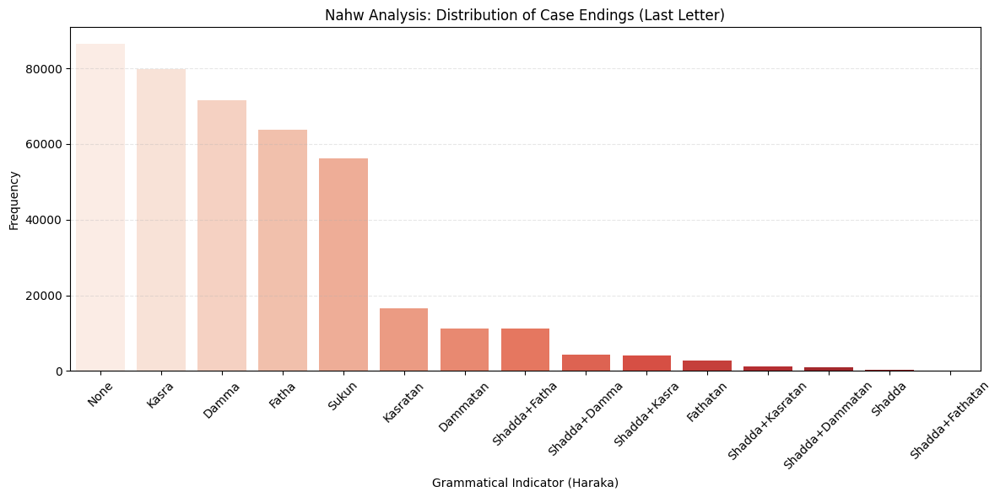

/tmp/ipykernel_243422/868830590.py:131: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=mid_df, x='Diacritic', order=mid_df['Diacritic'].value_counts().index, palette='Blues')


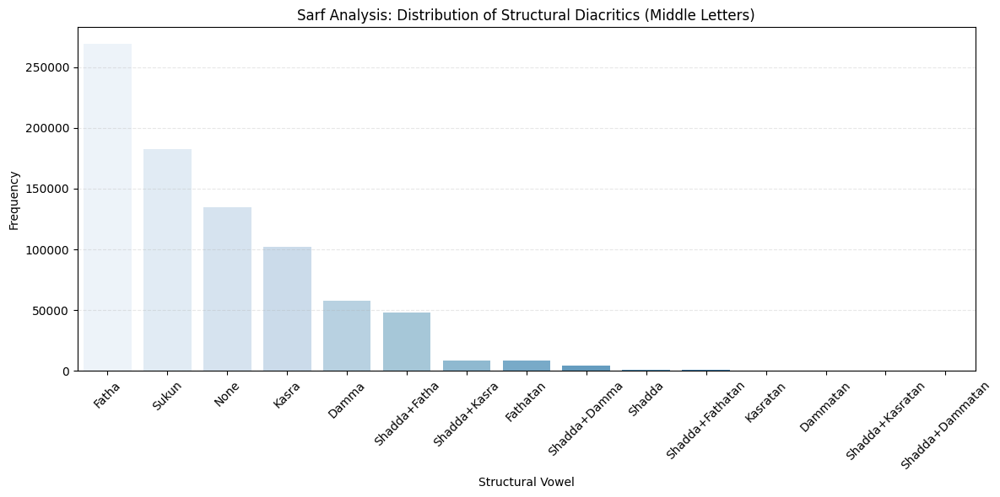

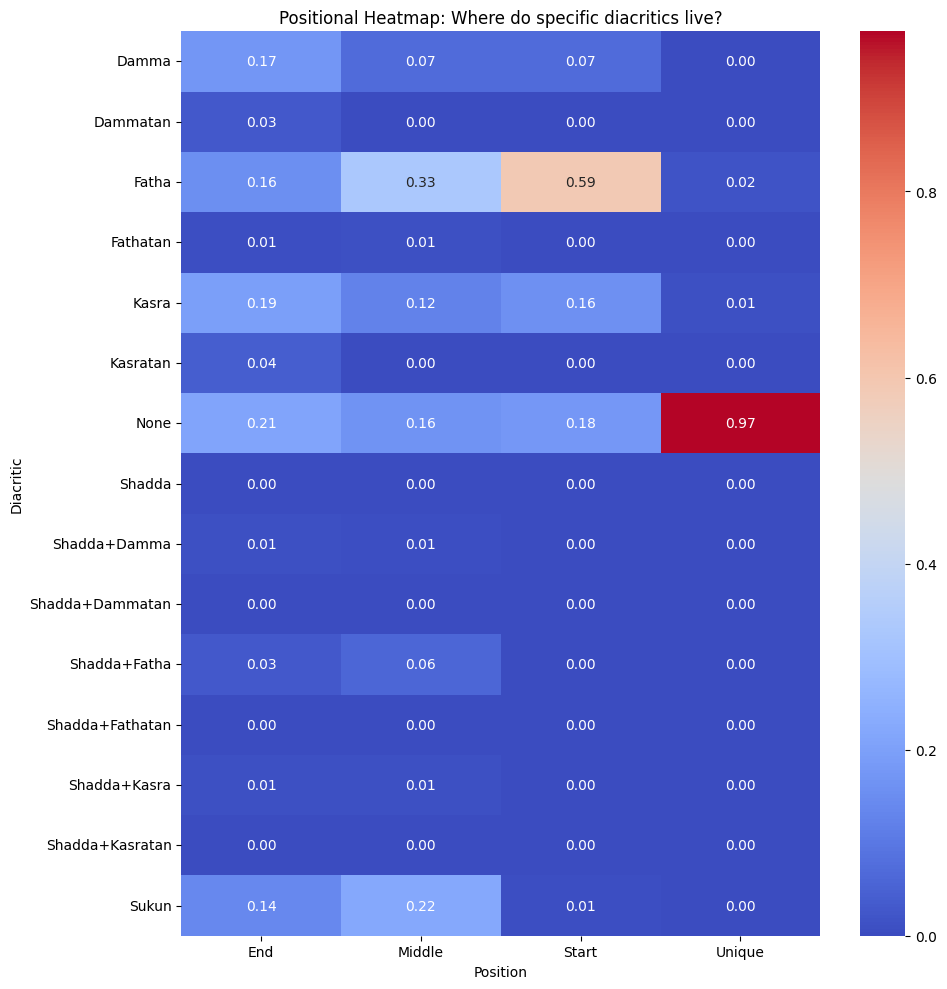


--- Top Abstract Word Patterns (Sarf Proxy) ---
Legend: 1=Vowel(Move), 0=Sukun(Stop), ~=Shadda, -=None
-: 50083
10: 31631
1011: 22384
101: 21990
111: 19352
11-: 18493
1-: 17723
11-1: 13667
110: 11986
1-1: 11077
1101: 9954
1111: 8118
11~1: 7979
11: 7965
1~: 7668
-0101: 7170
11~: 6307
11-11: 6117
101-: 6049
11011: 5821


In [59]:
import re
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from collections import Counter, defaultdict

# --- 1. The Tashkeel Dictionary ---
TASHKEEL_MAP = {
    '\u064b': 'Fathatan',   # ً
    '\u064c': 'Dammatan',   # ٌ
    '\u064d': 'Kasratan',   # ٍ
    '\u064e': 'Fatha',      # َ
    '\u064f': 'Damma',      # ُ
    '\u0650': 'Kasra',      # ِ
    '\u0651': 'Shadda',     # ّ
    '\u0652': 'Sukun',      # ْ
    # Complex Combinations
    '\u0651\u064e': 'Shadda+Fatha',
    '\u0651\u064f': 'Shadda+Damma',
    '\u0651\u0650': 'Shadda+Kasra',
    '\u0651\u064b': 'Shadda+Fathatan',
    '\u0651\u064c': 'Shadda+Dammatan',
    '\u0651\u064d': 'Shadda+Kasratan',
}

def analyze_linguistic_structure(lines):
    """
    Analyzes Arabic text at the WORD level to distinguish between
    Sarf (Internal Structure) and Nahw (Endings).
    """
    print("Starting Linguistic Analysis (Sarf & Nahw)...")
    
    char_data = []
    word_patterns = [] # Stores abstract patterns (e.g., CVCCV)
    
    # Regex to grab a full arabic word with its diacritics
    # Matches a sequence of (Arabic Letter + Optional Diacritics)+
    word_pattern = re.compile(r'((?:[^\u064b-\u0652\s][\u064b-\u0652]*)+)')
    
    # Regex to break a word into (Char, Diacritic) pairs
    char_diac_splitter = re.compile(r'([^\u064b-\u0652])([\u064b-\u0652]*)')

    for line in lines:
        words = word_pattern.findall(line)
        
        for word in words:
            # Break word into letters
            matches = char_diac_splitter.findall(word)
            word_len = len(matches)
            
            if word_len == 0: continue

            current_word_pattern = []

            for i, (char, diac) in enumerate(matches):
                # 1. Determine Position (Critical for Sarf vs Nahw)
                if word_len == 1:
                    position = "Unique" # Single letter words like 'wa'
                elif i == 0:
                    position = "Start"
                elif i == word_len - 1:
                    position = "End"    # The domain of Nahw
                else:
                    position = "Middle" # The domain of Sarf

                # 2. Normalize Diacritic
                if diac == "":
                    diacritic_name = "None"
                elif diac in TASHKEEL_MAP:
                    diacritic_name = TASHKEEL_MAP[diac]
                else:
                    diacritic_name = TASHKEEL_MAP.get(diac, "Complex/Other")
                
                # 3. Store Data
                char_data.append({
                    "Character": char,
                    "Diacritic": diacritic_name,
                    "Position": position
                })
                
                # Build Abstract Pattern (Simplified)
                # S = Sukun, A = Vowel (Harakat), ~ = Shadda
                if "Sukun" in diacritic_name: code = "0"
                elif "Shadda" in diacritic_name: code = "~"
                elif diacritic_name == "None": code = "-"
                else: code = "1" # Any movement (Fatha/Damma/Kasra)
                current_word_pattern.append(code)

            word_patterns.append("".join(current_word_pattern))

    df_chars = pd.DataFrame(char_data)
    
    # Top 20 most common "Rhythmic Patterns" (Wazn proxy)
    pattern_counts = Counter(word_patterns).most_common(20)
    
    return df_chars, pattern_counts

# --- Run Analysis ---
df_structure, top_patterns = analyze_linguistic_structure(new_lines) # Use your latest lines list
print(f"Analyzed {len(df_structure)} linguistic units.")

# --- Plotting Functions ---

def plot_nahw_analysis(df):
    """
    Plots the distribution of diacritics ONLY at the end of words.
    This gives insight into the Grammatical Case (I'rab).
    """
    # Filter for END of words
    end_df = df[df['Position'] == 'End']
    
    plt.figure(figsize=(12, 6))
    sns.countplot(data=end_df, x='Diacritic', order=end_df['Diacritic'].value_counts().index, palette='Reds')
    plt.title('Nahw Analysis: Distribution of Case Endings (Last Letter)')
    plt.xlabel('Grammatical Indicator (Haraka)')
    plt.ylabel('Frequency')
    plt.xticks(rotation=45)
    plt.grid(axis='y', linestyle='--', alpha=0.3)
    plt.tight_layout()
    plt.show()

def plot_sarf_analysis(df):
    """
    Plots the distribution of diacritics in the MIDDLE of words.
    This gives insight into Morphological Patterns (Sarf).
    """
    # Filter for MIDDLE of words
    mid_df = df[df['Position'] == 'Middle']
    
    plt.figure(figsize=(12, 6))
    sns.countplot(data=mid_df, x='Diacritic', order=mid_df['Diacritic'].value_counts().index, palette='Blues')
    plt.title('Sarf Analysis: Distribution of Structural Diacritics (Middle Letters)')
    plt.xlabel('Structural Vowel')
    plt.ylabel('Frequency')
    plt.xticks(rotation=45)
    plt.grid(axis='y', linestyle='--', alpha=0.3)
    plt.tight_layout()
    plt.show()

def plot_positional_heatmap(df):
    """
    Compares how diacritics shift based on position.
    Tanween should ONLY appear at 'End' or 'Unique'.
    """
    # Create Cross-Tabulation
    ct = pd.crosstab(df['Diacritic'], df['Position'])
    
    # Normalize by Column (Position) to compare relative frequencies
    ct_norm = ct.div(ct.sum(axis=0), axis=1)
    
    plt.figure(figsize=(10, 10))
    sns.heatmap(ct_norm, cmap='coolwarm', annot=True, fmt='.2f')
    plt.title('Positional Heatmap: Where do specific diacritics live?')
    plt.tight_layout()
    plt.show()

# --- Generate the Linguistic Plots ---
plot_nahw_analysis(df_structure)
plot_sarf_analysis(df_structure)
plot_positional_heatmap(df_structure)

# Print Top Patterns
print("\n--- Top Abstract Word Patterns (Sarf Proxy) ---")
print("Legend: 1=Vowel(Move), 0=Sukun(Stop), ~=Shadda, -=None")
for pat, count in top_patterns:
    print(f"{pat}: {count}")

In [60]:

# Define Arabic Diacritics (Tashkeel) range
# Unicode: 064B to 0652 (Fathatan, Dammatan, Kasratan, Fatha, Damma, Kasra, Shadda, Sukun)
DIACRITICS_PATTERN = re.compile(r'[\u064B-\u0652]')

def split_text_and_diacritics(text):
    """
    Splits a diacritized string into:
    1. clear_text: The text with diacritics removed.
    2. labels: A list of diacritics corresponding to each character in clear_text.
    """
    letters = []
    labels = []
    
    i = 0
    while i < len(text):
        char = text[i]
        
        # If the character is a diacritic, add it to the *previous* letter's label
        if DIACRITICS_PATTERN.match(char):
            if labels:
                labels[-1] += char
            # If a string starts with a diacritic (rare/error), we ignore or attach to nothing
        
        # If it's a normal character (letter, space, punctuation)
        else:
            letters.append(char)
            labels.append("") # Initialize with "No Diacritic" (empty string)
            
        i += 1
        
    return "".join(letters), labels

# Example Test
sample = "كَتَبَ الْوَلَدُ"
text, labs = split_text_and_diacritics(sample)

print(f"Original: {sample}")
print(f"Text:     {list(text)}") 
print(f"Labels:   {labs}")
# Expected Labels: ['َ', 'َ', 'َ', '', '', 'ْ', 'َ', 'َ', 'َ', 'ُ']

Original: كَتَبَ الْوَلَدُ
Text:     ['ك', 'ت', 'ب', ' ', 'ا', 'ل', 'و', 'ل', 'د']
Labels:   ['َ', 'َ', 'َ', '', '', 'ْ', 'َ', 'َ', 'ُ']


In [61]:
all_diacritics_in_data = set()
for new_line in new_lines:
    _, labs = split_text_and_diacritics(new_line)
    all_diacritics_in_data.update(labs)

tashkeel = sorted(list(all_diacritics_in_data))

label2id = {label: i for i, label in enumerate(tashkeel)}
id2label = {i: label for i, label in enumerate(tashkeel)}

print(f"Total Unique tashkeel Found: {len(tashkeel)}")
print("-" * 30)
for idx, label in id2label.items():
    print(f"Class {idx}: {repr(label)}")

Total Unique tashkeel Found: 15
------------------------------
Class 0: ''
Class 1: 'ً'
Class 2: 'ٌ'
Class 3: 'ٍ'
Class 4: 'َ'
Class 5: 'ُ'
Class 6: 'ِ'
Class 7: 'ّ'
Class 8: 'ًّ'
Class 9: 'ٌّ'
Class 10: 'ٍّ'
Class 11: 'َّ'
Class 12: 'ُّ'
Class 13: 'ِّ'
Class 14: 'ْ'


In [62]:
punctuation = [' ', '،', ':', '؛', '!', '؟', '"', "'", '«', '»', '(', ')', '[', ']', '{', '}', '-', '.']

In [63]:
cleaned_text = []
cleaned_tashkeel = []

In [64]:
for new_line in new_lines:
    new_line = re.sub(r'\s+', ' ', new_line).strip()
    if not new_line.strip():
        continue
    text, tashkeel = split_text_and_diacritics(new_line)
    if len(text) < 10:
        continue
    if text in punctuation:
        print("helo")
    cleaned_text.append(text)
    cleaned_tashkeel.append(tashkeel)

In [65]:
for i in range(len(cleaned_text)):
    assert len(cleaned_text[i]) == len(cleaned_tashkeel[i])

## TA checks

In [66]:
import pickle

file_path = '../utils/arabic_letters.pickle' 

with open(file_path, 'rb') as f:
    arabic_letters = pickle.load(f)
print(arabic_letters)

{'د', 'ي', 'ئ', 'ذ', 'ن', 'ف', 'خ', 'م', 'ى', 'ص', 'ه', 'س', 'ث', 'ع', 'ش', 'ب', 'ء', 'ؤ', 'أ', 'ج', 'ط', 'ض', 'و', 'ا', 'ة', 'إ', 'ك', 'ز', 'ل', 'ظ', 'غ', 'ح', 'ت', 'ر', 'ق', 'آ'}


In [67]:
file_path = '../utils/diacritic2id.pickle' 

with open(file_path, 'rb') as f:
    diacritic2id = pickle.load(f)
print(diacritic2id)

{'َ': 0, 'ً': 1, 'ُ': 2, 'ٌ': 3, 'ِ': 4, 'ٍ': 5, 'ْ': 6, 'ّ': 7, 'َّ': 8, 'ًّ': 9, 'ُّ': 10, 'ٌّ': 11, 'ِّ': 12, 'ٍّ': 13, '': 14}


In [68]:
ta_keys = set(diacritic2id.keys())
user_keys = set(label2id.keys())

missing_in_ta = user_keys - ta_keys
missing_in_user = ta_keys - user_keys

if not missing_in_ta and not missing_in_user:
    print("Match")
else:
    print("❌ MISMATCH FOUND:")
    if missing_in_ta:
        print(f"  - Your data has these extras: {missing_in_ta}")
    if missing_in_user:
        print(f"  - TA code expects these but you don't have them: {missing_in_user}")

Match


## Data statistics

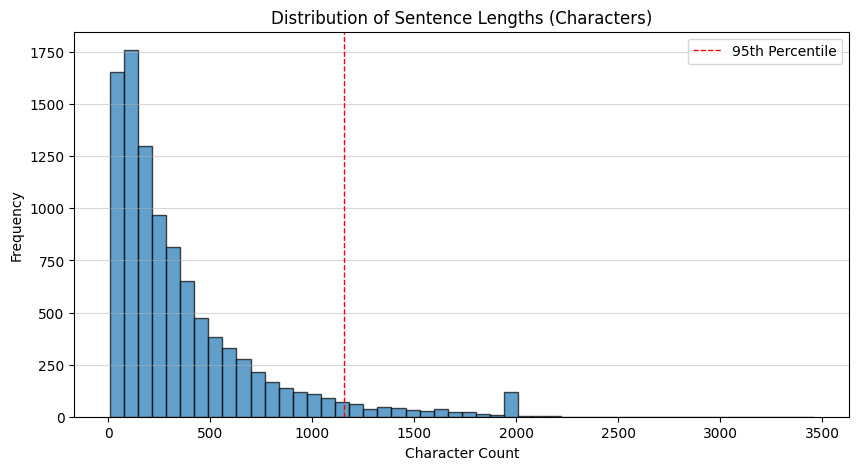

In [69]:
df_og = pd.DataFrame({'Text': lines})
df_og['char_length'] = df_og['Text'].str.len()
plt.figure(figsize=(10, 5))
plt.hist(df_og['char_length'], bins=50, color='#1f77b4', edgecolor='black', alpha=0.7)
plt.title('Distribution of Sentence Lengths (Characters)')
plt.xlabel('Character Count')
plt.ylabel('Frequency')
plt.axvline(df_og['char_length'].quantile(0.95), color='r', linestyle='dashed', linewidth=1, label='95th Percentile')
plt.legend()
plt.grid(axis='y', alpha=0.5)
plt.savefig('length_distribution.png')

In [70]:
df = pd.DataFrame({'Text': cleaned_text, 'Tashkeel': cleaned_tashkeel})

In [71]:
df.head()

,Text,Tashkeel
0,ولو جمع ثم علم ترك ركن من الأولى بطلتا ويعيدهم...,"[َ, َ, ْ, , َ, َ, َ, , ُ, َّ, , َ, ِ, َ, , َ, ..."
1,قال أبو زيد أهل تهامة يؤنثون العضد وبنو تميم ي...,"[َ, , َ, , َ, ُ, , , َ, ْ, ٍ, , َ, ْ, ُ, , ِ, ..."
2,بمنزلة أهل الذمة إذا دخلوا قرية من قرى أهل الح...,"[ِ, َ, ْ, ِ, َ, ِ, , َ, ْ, ِ, , , , ِّ, َّ, ِ,..."
3,المسألة الخامسة,"[, ْ, َ, ْ, َ, َ, ُ, , , ْ, َ, , ِ, َ, ُ]"
4,قوله تعالى : { الذين يظاهرون } حقيقته تشبيه ظه...,"[َ, ْ, , , , َ, َ, , َ, , , , , , , , َّ, ِ, ,..."


In [72]:
def plot_length_distribution(df, percentile=0.95, save_path=None):
    plt.figure(figsize=(10, 5))
    plt.hist(df['char_length'], bins=50, color='#1f77b4', edgecolor='black', alpha=0.7)
    plt.title('Distribution of Sentence Lengths (Characters)')
    plt.xlabel('Character Count')
    plt.ylabel('Frequency')
    plt.axvline(df['char_length'].quantile(percentile), color='r', linestyle='dashed', linewidth=1, label=f'{percentile} Percentile')
    plt.legend()
    plt.grid(axis='y', alpha=0.5)
    if save_path:
        plt.savefig(save_path)

In [73]:
df['char_length'] = df['Text'].str.len()

In [74]:
df[df['char_length'] > 500]

,Text,Tashkeel,char_length
15,لو أخذ ثلاثة أرضا بالنصف ليزرعوها بالشركة فغاب...,"[َ, ْ, , َ, َ, َ, , َ, َ, , َ, ٌ, , َ, ْ, ً, ,...",529
26,وقول أنس فقمت إلى مهراس لنا فضربتها بأسفله حتى...,"[َ, َ, ْ, ُ, , َ, َ, ٍ, , َ, ُ, ْ, , , ِ, َ, ,...",563
55,وإن كان المأذون هو الوكيل للأجنبي ببيع شيء أو ...,"[َ, ِ, ْ, , َ, , َ, , , ْ, َ, ْ, ُ, , ُ, , ُ, ...",521
80,روى ابن حبيب عن مطرف وابن الماجشون وابن عبد ال...,"[َ, َ, , , , ْ, ُ, , َ, ِ, , ٍ, , َ, ْ, , ُ, َ...",589
92,( ومن سافرت وحدها بغير إذنه ناشزة ) فلا قسم له...,"[, , َ, َ, ْ, , َ, , َ, َ, ْ, , َ, ْ, َ, َ, , ...",502
...,...,...,...
15190,حدثنا عبد الرزاق أخبرنا سفيان وأبو نعيم قال حد...,"[َ, َّ, َ, َ, , , َ, ْ, ُ, , , , َّ, َّ, , ِ, ...",525
15193,حدثنا روح قال ثنا محمد بن أبي حفصة قال ثنا الز...,"[َ, َّ, َ, َ, , , َ, ْ, ٌ, , َ, , َ, , َ, َ, ,...",507
15292,فقوله للإحراز يرجع للأولى على نص المدونة وللثا...,"[َ, َ, ْ, ُ, ُ, , ِ, ْ, ِ, ْ, َ, , ِ, , َ, ْ, ...",566
15324,المجموع ، وكلامهما في الكراهة السابقة محمول عل...,"[, ْ, َ, ْ, ُ, , ِ, , , , َ, َ, َ, , ُ, ُ, َ, ...",563


In [75]:
df[df['char_length'] <= 5]

,Text,Tashkeel,char_length


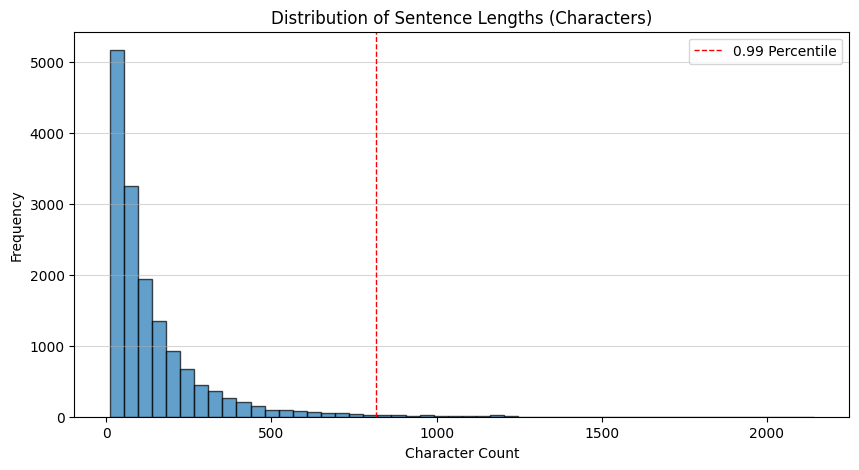

In [76]:
plot_length_distribution(df, percentile=0.99)

In [77]:
df = df[df['char_length'] > 5].reset_index(drop=True)

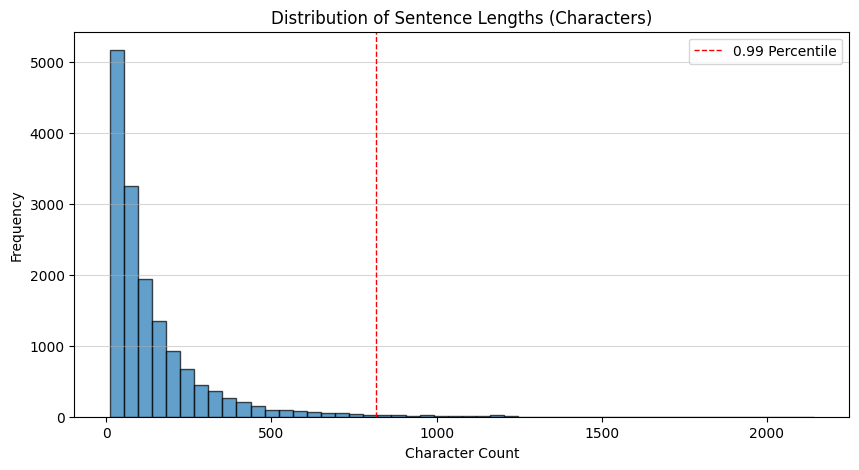

In [78]:
plot_length_distribution(df, percentile=0.99)

In [79]:
MAX_LEN = df['char_length'].quantile(0.99).astype(np.int32)

In [80]:
df[df['char_length'] > MAX_LEN]

,Text,Tashkeel,char_length
117,ولده والثلث يحتملها وهلك وترك زوجته وأمه وولده...,"[َ, َ, ِ, ِ, , َ, , , ُّ, ُ, ُ, , َ, ْ, َ, ِ, ...",1012
204,قوله ( يبينان السارق ، والمسروق منه ) وقدر الم...,"[َ, ْ, ِ, ِ, , , , ُ, َ, ِّ, َ, , ِ, , , , َّ,...",902
235,قال : وإذا اشترى عبدا بألف فلم يقبضه ولم ينقد ...,"[َ, , َ, , , , َ, ِ, َ, , , , ْ, َ, َ, , , َ, ...",1166
431,وإن ترك عبدين قيمة كل واحد ألف وثلث ماله ألف ،...,"[َ, ِ, ْ, , َ, َ, َ, , َ, ْ, َ, ْ, ِ, , ِ, , َ...",957
542,قال : ( والرأس ، أو الوجه فما يوضح وينقل عظمه ...,"[َ, , َ, , , , , , َ, , , َّ, ْ, ُ, , , , َ, ْ...",1140
...,...,...,...
15019,والوطء في غير الملك يوجب الحد إلا أنه سقط للشب...,"[َ, , ْ, َ, ْ, ُ, , ِ, , , َ, ْ, ِ, , , ْ, ِ, ...",1185
15027,وللخنثى خمسة وسبع وبيان ذلك أن تضرب الواحد في ...,"[َ, ِ, ْ, ُ, ْ, َ, , , َ, ْ, َ, ٌ, , َ, ُ, ُ, ...",1024
15071,شكا في المعية قال شيخنا : فالظاهر أنهما يطهران...,"[َ, َّ, , , ِ, , , , ْ, َ, ِ, َّ, ِ, , َ, , َ,...",866
15118,قال حدثنا أبو محمد عبد الملك بن هشام قال حدثنا...,"[َ, , َ, , َ, ّ, َ, َ, , , َ, ُ, , , ُ, َ, ّ, ...",1372


In [81]:
curr = df[df['char_length'] > MAX_LEN].iloc[0]['Text']

In [82]:
def slide_window(text, labels, overlap=50, max_len=200):
    assert len(text) == len(labels), "Text and labels must be of the same length."
    if len(text) <= max_len:
        return [text], [labels]
    
    text_chunks = []
    label_chunks = []
    
    stride = max_len - overlap
    
    for i in range(0, len(text), stride):
        t_chunk = text[i : i + max_len]
        
        l_chunk = labels[i : i + max_len]
        
        text_chunks.append(t_chunk)
        label_chunks.append(l_chunk)
        
        if i + max_len >= len(text): 
            break
            
    return (text_chunks, label_chunks)


In [83]:
chunked_lines = []
chunked_labels = []
for i, new_line in enumerate(cleaned_text):
    chunks = slide_window(new_line, cleaned_tashkeel[i], overlap=50, max_len=MAX_LEN)
    if len(chunks) > 1:
        print(f"Original Length: {(new_line)} \n Chunks: {(chunks[0])}")
    for i, chunk in enumerate(chunks[0]):
        chunked_lines.append(chunk)
        chunked_labels.append(chunks[1][i])


Original Length: ولو جمع ثم علم ترك ركن من الأولى بطلتا ويعيدهما جامعا ، أو من الثانية ، فإن لم يطل تدارك ، وإلا فباطلة ولا جمع ، ولو جهل أعادهما لوقتيهما 
 Chunks: ['ولو جمع ثم علم ترك ركن من الأولى بطلتا ويعيدهما جامعا ، أو من الثانية ، فإن لم يطل تدارك ، وإلا فباطلة ولا جمع ، ولو جهل أعادهما لوقتيهما']
Original Length: قال أبو زيد أهل تهامة يؤنثون العضد وبنو تميم يذكرون ، والجمع أعضد وأعضاد مثل أفلس وأقفال 
 Chunks: ['قال أبو زيد أهل تهامة يؤنثون العضد وبنو تميم يذكرون ، والجمع أعضد وأعضاد مثل أفلس وأقفال']
Original Length: بمنزلة أهل الذمة إذا دخلوا قرية من قرى أهل الحرب ثم ظفر المسلمون بها فهم فيء أجمعون إلا من عرف أنه ذمي . 
 Chunks: ['بمنزلة أهل الذمة إذا دخلوا قرية من قرى أهل الحرب ثم ظفر المسلمون بها فهم فيء أجمعون إلا من عرف أنه ذمي .']
Original Length: المسألة الخامسة 
 Chunks: ['المسألة الخامسة']
Original Length: قوله تعالى : { الذين يظاهرون } حقيقته تشبيه ظهر [ بظهر ، والموجب للحكم منه تشبيه ظهر ] محلل بظهر محرم ، ويتفرع عليه فروع كثيرة ، أصولها سبعة : الفرع الأول : إذا شب

In [84]:
MAX_LEN

np.int32(815)

In [85]:
print(max(len(line) for line in chunked_lines))

815


## Checks

In [86]:
char_set = {}
for line in chunked_lines:

    for char in line:
        if char in char_set:
            continue
        else:
            if char not in arabic_letters and char not in punctuation and char not in label2id:
                print(f"Char {repr(char)} not found in arabic_letters list.")   
            char_set[char] = 1


Char '<' not found in arabic_letters list.
Char 'U' not found in arabic_letters list.
Char 'N' not found in arabic_letters list.
Char 'K' not found in arabic_letters list.
Char '>' not found in arabic_letters list.


In [87]:
label2id

{'': 0,
 'ً': 1,
 'ٌ': 2,
 'ٍ': 3,
 'َ': 4,
 'ُ': 5,
 'ِ': 6,
 'ّ': 7,
 'ًّ': 8,
 'ٌّ': 9,
 'ٍّ': 10,
 'َّ': 11,
 'ُّ': 12,
 'ِّ': 13,
 'ْ': 14}

In [88]:
def pad_tokens(tokens_text, tokens_labels, max_len):
    if len(tokens_text) == max_len:
        return (tokens_text[:max_len], tokens_labels[:max_len])
    elif len(tokens_text) < max_len:
        return (tokens_text + ['<PAD>'] * (max_len - len(tokens_text)), 
                tokens_labels + [''] * (max_len - len(tokens_labels)))

In [89]:
chunked_lines[0]

'ولو جمع ثم علم ترك ركن من الأولى بطلتا ويعيدهما جامعا ، أو من الثانية ، فإن لم يطل تدارك ، وإلا فباطلة ولا جمع ، ولو جهل أعادهما لوقتيهما'

In [90]:
padded_texts = []
padded_labels = []
for i, line in enumerate(chunked_lines):
    padded_text, padded_label = pad_tokens(list(line), chunked_labels[i], MAX_LEN)
    padded_texts.append(padded_text)
    padded_labels.append(padded_label)

In [91]:
all_diacritics_in_data = set()
for labels in chunked_labels:
    all_diacritics_in_data.update(labels)

tashkeel = sorted(list(all_diacritics_in_data))

label2id = {label: i for i, label in enumerate(tashkeel)}

In [92]:
# json dump
import json
with open('diacritic2id.json', 'w', encoding='utf-8') as f:
    json.dump(diacritic2id, f, ensure_ascii=False, indent=4)

In [ ]:
diacritic2id

{'َ': 0,
 'ً': 1,
 'ُ': 2,
 'ٌ': 3,
 'ِ': 4,
 'ٍ': 5,
 'ْ': 6,
 'ّ': 7,
 'َّ': 8,
 'ًّ': 9,
 'ُّ': 10,
 'ٌّ': 11,
 'ِّ': 12,
 'ٍّ': 13,
 '': 14}

In [696]:
def build_vocab(padded_texts):
    char_set = {
        '<PAD>' : 0,
        '<UNK>' : 1
    }
    i = 2
    for text in padded_texts:
        for char in text:
            if char not in char_set:
                char_set[char] = i
                i += 1
    
    return char_set

In [697]:
vocab = build_vocab(padded_texts)

In [698]:
for letter in arabic_letters:
    if letter not in vocab:
        print("error")

In [699]:
for letter in vocab:
    if letter not in arabic_letters:
        print(letter)

<PAD>
<UNK>
 
،
.
:
{
}
[
]
(
)
؛
؟
<
U
N
K
>
-
!
'
«
»
"


## SAVE !!!